# <img src="https://img.icons8.com/bubbles/100/000000/3d-glasses.png" style="height:50px;display:inline"> EE 046746 - Technion - Computer Vision


## Homework 3 - Segmentation and Homographies
---

### <a style='color:red'> Due Date: 14.8.2024 </a>

### <img src="https://img.icons8.com/bubbles/50/000000/upload-to-cloud.png" style="height:50px;display:inline"> Submission Guidelines
---
#### READ THIS CAREFULLY
* Submission only in **pairs**.
* **No handwritten submissions**.
* You can choose your working environment:
    * You can work in a `Jupyter Notebook`, locally with <a href="https://www.anaconda.com/distribution/">Anaconda</a> or online on <a href="https://colab.research.google.com/">Google Colab</a>
  * **Important**: Colab also supports running code on GPU, so if you don't have one, Colab is the way to go. To enable GPU on Colab, in the menu: `Runtime` $\rightarrow$  `Change Runtime Type` $\rightarrow$`GPU`.
    * You can work in a Python IDE such as <a href="https://www.jetbrains.com/pycharm/">PyCharm</a> or <a href="https://code.visualstudio.com/">Visual Studio Code</a>.
        * Both also allow opening/editing Jupyter Notebooks.

* Make sure you submit your exercise according to the requirements in the <a href="https://moodle.technion.ac.il/pluginfile.php/1823033/mod_resource/content/2/Homework%20guidelines.pdf">"Homework submission guidelines"</a> file that appears in the course website (Moodle). 
* **The code should run both on CPU and GPU without manual modifications**, require no special preparation and run on every computer.
* Be precise, we expect on point answers.
* Submission on the course website (Moodle).

### <img src="https://img.icons8.com/dusk/64/000000/python.png" style="height:50px;display:inline"> Python Libraries
---

* `numpy`
* `matplotlib`
* `pytorch` (and `torchvision`)
* `opencv` (or `scikit-image`)
* `scikit-learn`
* Anything else you need (`PIL`, `os`, `pandas`, `csv`, `json`,...)

### Quick note
in this task, you will be required to use Deep learning segmentation methods. for that, you can use any method that has been presented in class, including but not limited to SegmentAnything,Mask-RCNN, and more.
if you choose SegmentAnything, use the following link to see an example for usage: <a href="https://github.com/facebookresearch/segment-anything">link here</a>. Note: if you use SAM, you must in order to use it, download pre-trained weights. please note in the report which model-type you chose, the link to the download. DO NOT include the pre-traiend weights

#### Installing segment-anything package:

In [1]:
#! pip install git+https://github.com/facebookresearch/segment-anything.git 

### <img src="https://img.icons8.com/bubbles/50/000000/checklist.png" style="height:50px;display:inline"> Tasks
---
* In all tasks, you should document your process and results in a report file (which will be saved as `.pdf`). 
* You can reference your code in the report file, but no need for actual code in this file, the code is submitted in a seprate folder as explained above.

#### Part 1 - Classic Vs. Deep Learning-based Semantic Segmentation
---
In this part you are going to compare classic methods for segmentation to deep learning-based methods. 

1. Load the images in the `./data/frogs` and `./data/horses` folders and display them.
2. Pick 1 classic method for segmentation and 1 deep learning-based method and segment the given images. Display the results.
    * **Briefly** summarize each method you picked and discuss the advantages and disadvantages of each method. In your answer, relate to the results you received in this section.
    * You can use a ready implementation from the internet or OpenCV, no need to implement it yourselves.
    * Note: the classic method **must not** use any neural network.
3. Pick 3 images (download from the internet or take them yourself) that satisfy the following, and dispaly them:
    * One image of a living being (human, animal,...).
    * One image of commonly-used object (car, chair, smartphone, glasses,...).
    * One image of not-so-commonly-used object (fire extinguisher, satellite,... **BE CREATIVE**).
4. Apply each method (one classic and one deep learning-based) on the 3 images. Display the results (mask and segmented image).
    * Which method performed better on each image? Describe your thoughts on why one method is better than the other.
    * For the classic method you can change parameters per-image, document them in the report.
    * You can add manual post-processing to get a mask if needed. If you do that, document in your report "how hard" you had to work in the post-processing stage, as it's an indication of the quality of the method.
5. As you probably have noticed, segmentation can be rough around the edges, i.e., the mask is not perfect and may be noisy around the edges. What can be done to fix or at least alleviate this problem? Your suggestions can be in pre-processing, inside the segmentation algorithm or in post-processing.

1. Load and disply images

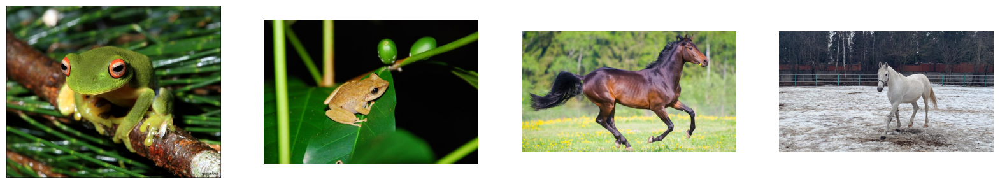

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
%matplotlib inline

def load_images():
    imgs = []
    imgs.append(cv2.imread(r'../data/frogs/frog1.jpg'))
    imgs.append(cv2.imread(r'../data/frogs/frog2.jpg'))
    imgs.append(cv2.imread(r'../data/horses/horse1.png'))
    imgs.append(cv2.imread(r'../data/horses/horse2.jpg'))
    return imgs

def display_images(imgs):
    plt.figure(figsize=(20,40))
    for i,im in enumerate(imgs):
        plt.subplot(1,4,i+1)
        plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
        _ = plt.axis('off')

imgs = load_images()
display_images(imgs)

2. Classic method - K-means

In [3]:
from sklearn.cluster import KMeans
def kMeans_segmentation(imgs, K = [2,3,5,10]):
    if isinstance(K, int):
        K = [K]
    segmented_images = []
    for i,img in enumerate(imgs):
        for j,k in enumerate(K):
            if not ((i+1) % 100):
                print(f'Segmenting image #{i+1} with {k} clusters')
            model = KMeans(n_clusters = k)
            img_for_clusetring = np.float32(img.reshape((-1,3)))
            clusters = model.fit_predict(img_for_clusetring)
            centers = model.cluster_centers_
            centers = np.uint8(centers)
            segmented_images.append(centers[clusters.flatten()].reshape(img.shape)) 
    return segmented_images

In [4]:
K = [2,3,5,10]
segmented_images = kMeans_segmentation(imgs)

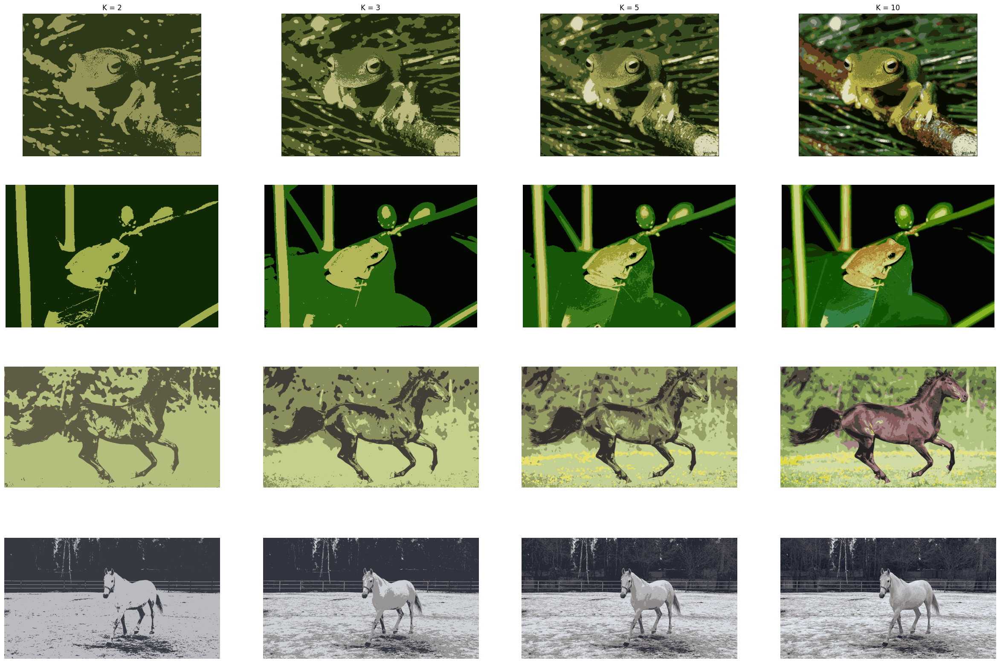

In [5]:
plt.figure(figsize=(30,20))
for i in range(len(imgs)):
    for j,k in enumerate(K):
        plt.subplot(4,4,4*i+j+1)
        plt.imshow(cv2.cvtColor(segmented_images[4*i+j], cv2.COLOR_BGR2RGB))
        _ = plt.axis('off')
        if not i:
            plt.title(f'K = {k}')

2. Deep learning segmentation using SAM

In [6]:
from segment_anything import SamAutomaticMaskGenerator, sam_model_registry
sam = sam_model_registry["vit_h"](checkpoint="../data/my_data/sam_vit_h_4b8939.pth")
mask_generator = SamAutomaticMaskGenerator(sam)

c:\work\CV\046746---Algorithms-and-Applications-in-Computer-Vision\.venv\Lib\site-packages\segment_anything\build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

In [ ]:
segmented_images_SAM = []
for i in range(len(imgs)):
    segmented_images_SAM.append(mask_generator.generate(imgs[i]))

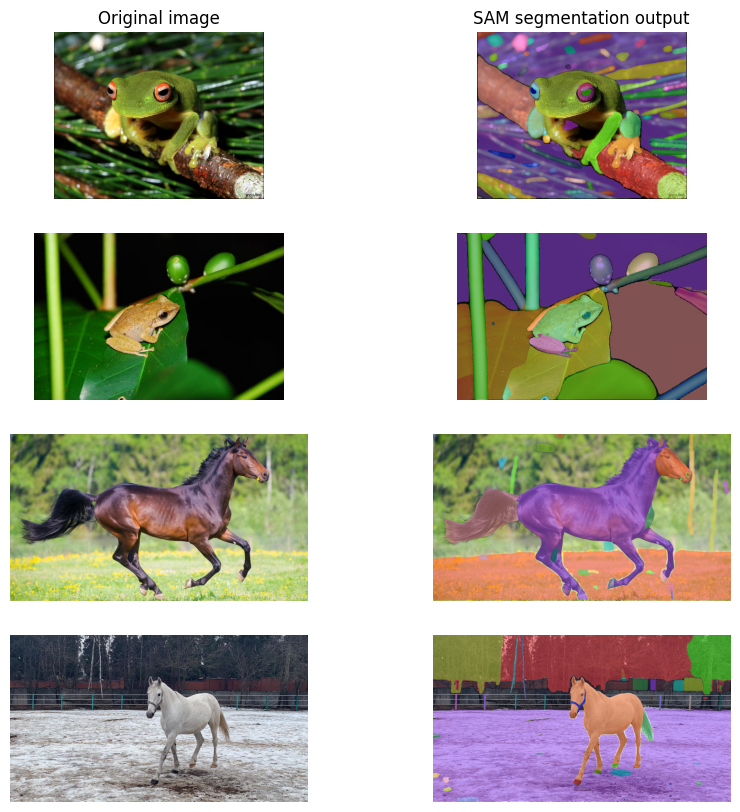

In [ ]:
import supervision as sv

mosaic_images_SAM = []
imgs = load_images()

plt.figure(figsize=(10,10))
for i in range(len(imgs)):
    plt.subplot(4,2,2*i+1)
    plt.imshow(cv2.cvtColor(imgs[i], cv2.COLOR_BGR2RGB))
    if not i:
        plt.title(f'Original image')
    _ = plt.axis('off')
    mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)
    detections = sv.Detections.from_sam(segmented_images_SAM[i])
    annotated_image = mask_annotator.annotate(imgs[i], detections)
    plt.subplot(4,2,2*i+2)
    plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
    _ = plt.axis('off')
    if not i:
        plt.title(f'SAM segmentation output')


3. Load and display my images

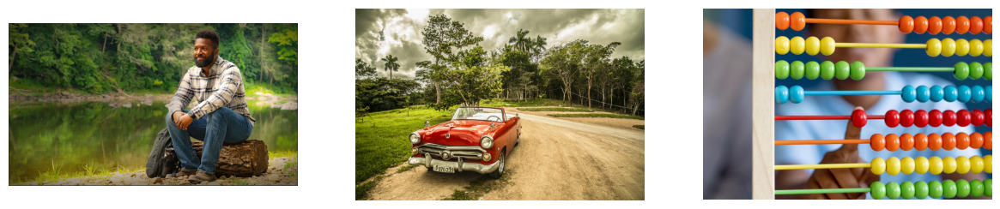

In [ ]:
def load_my_images():
    imgs = []
    imgs.append(cv2.imread(r'../data/my_data/person.png'))
    imgs.append(cv2.imread(r'../data/my_data/car.png'))
    imgs.append(cv2.imread(r'../data/my_data/abacus.png'))
    return imgs

my_imgs = load_my_images()
display_images(my_imgs)

4. Segment images kMeans

In [ ]:
K = [2,3,5,10]
segmented_images = kMeans_segmentation(my_imgs)

Segmenting image #1 with 2 clusters
Segmenting image #1 with 3 clusters
Segmenting image #1 with 5 clusters
Segmenting image #1 with 10 clusters
Segmenting image #2 with 2 clusters
Segmenting image #2 with 3 clusters
Segmenting image #2 with 5 clusters
Segmenting image #2 with 10 clusters
Segmenting image #3 with 2 clusters
Segmenting image #3 with 3 clusters
Segmenting image #3 with 5 clusters
Segmenting image #3 with 10 clusters


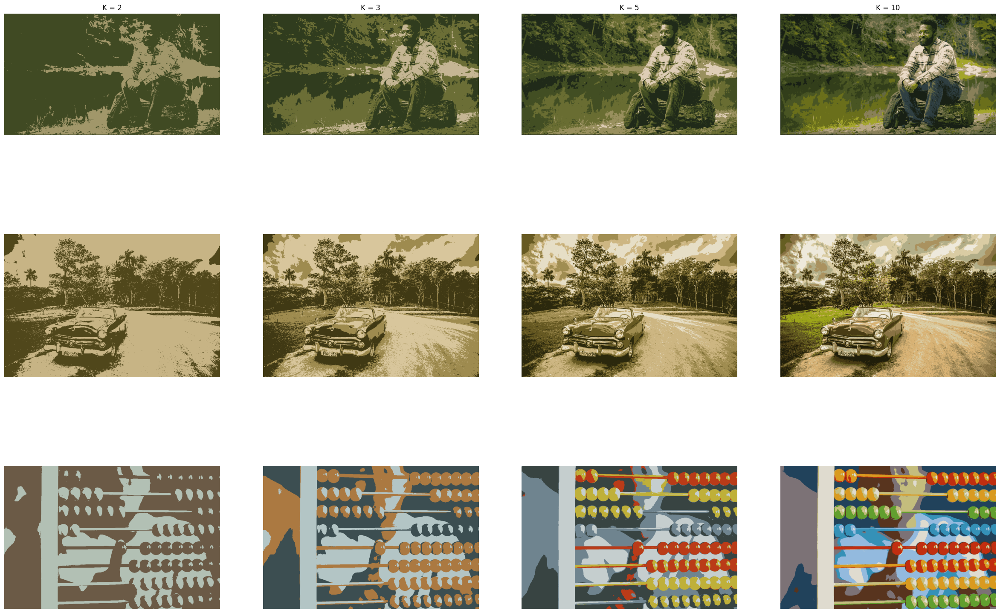

In [ ]:
plt.figure(figsize=(30,20))
for i in range(len(my_imgs)):
    for j,k in enumerate(K):
        plt.subplot(3,4,4*i+j+1)
        plt.imshow(cv2.cvtColor(segmented_images[4*i+j], cv2.COLOR_BGR2RGB))
        _ = plt.axis('off')
        if not i:
            plt.title(f'K = {k}')

In [ ]:
segmented_myimages_SAM = []
for i in range(len(my_imgs)):
    segmented_myimages_SAM.append(mask_generator.generate(my_imgs[i]))

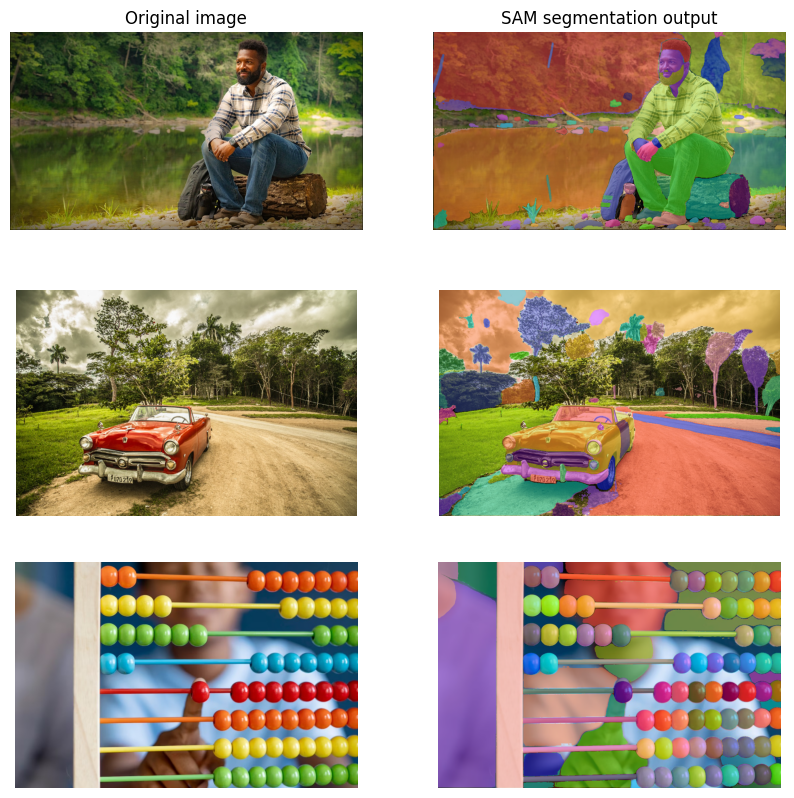

In [ ]:
my_imgs = load_my_images()

plt.figure(figsize=(10,10))
for i in range(len(my_imgs)):
    plt.subplot(3,2,2*i+1)
    plt.imshow(cv2.cvtColor(my_imgs[i], cv2.COLOR_BGR2RGB))
    if not i:
        plt.title(f'Original image')
    _ = plt.axis('off')
    mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)
    detections = sv.Detections.from_sam(segmented_myimages_SAM[i])
    annotated_image = mask_annotator.annotate(my_imgs[i], detections)
    plt.subplot(3,2,2*i+2)
    plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
    _ = plt.axis('off')
    if not i:
        plt.title(f'SAM segmentation output')


#### Part 2 - Jurrasic Fishbach
---
In this part you are going to apply segmentation on a video, and integrate with other elements.

<img src="https://lh3.googleusercontent.com/5zF16wl-tdE1FZCuVsrNxHWzfa6uXo4hYE_BGabKnGovw2W-bIT9gnZlAgU8nUoK=w412-h220-rw">

1. Film a short video of yourself (you can use your phone for that), but without too much camera movement. You on the other hand, can move however you want (we expect you to). Convert the video to frames and resize the images for a reasonable not too high resolution (lower than 720p ~ 1280x720 pixles). You can use the function in `./code/frame_video_convert.py` to help you. Display 2 frames in the report.
2. Segment yourself out of the video (frame-by-frame) using one of the methods (classic or deep). Display 2 frames in the report. 
3. Pick one of the objects in the supplied videos file (`./data/video_models`), convert it to images and segement it out using one of the methods from Part 1(classic or deep). Display 2 frames in the report. You can choose another object from: https://pixabay.com/videos/search/green%20screen/.
    * Explain how you performed the sementation for this specific type of video (i.e., green-screen videos). Did you  use a simple/classic method? Deep method? Combined both?
4. Put it all together - pick a background, put yourself and the segemented object on the background. Stich it frame-by-frame (don't make the video too long or it will take a lot of time, 10secs maximum). Display 2 frames of the result in your report. Convert the frames back to video. You can use the function in `frame_video_convert.py` to help you.
    * Tip: To make it look good, you can resize the images, create a mapping from pixel locations in the original image to pixels locations in the new image.
    * You should submit the final video in the `./output` folder (**MANDATORY**).
    * We expect some creative results, this can benefit you a lot when you want to demonstrate your Computer Vision abilities.

First well build some helper functions:

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random
from sklearn.cluster import KMeans

random.seed(305295818)

def kMeans_segmentation(imgs, K = [2,3,5,10]):
    if isinstance(K, int):
        K = [K]
    segmented_images = []
    for i,img in enumerate(imgs):
        for j,k in enumerate(K):
            if not ((i+1) % 100):
                print(f'Segmenting image #{i+1} with {k} clusters')
            model = KMeans(n_clusters = k)
            img_for_clusetring = np.float32(img.reshape((-1,3)))
            clusters = model.fit_predict(img_for_clusetring)
            centers = model.cluster_centers_
            centers = np.uint8(centers)
            segmented_images.append(centers[clusters.flatten()].reshape(img.shape)) 
    return segmented_images

def load_video_to_image_list(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise ValueError("Error opening video file")
    frames = []
    while True:
        ret_code , frame = cap.read()
        if not ret_code:
            break
        frames.append(cv2.resize(frame, (0, 0), fx=0.75, fy=0.75))
    cap.release()
    return frames

def frames_to_masks_dino(frames, K=[2]):
    masks = []
    segmented_frames = kMeans_segmentation(frames, K = K)
    for seg_frame in segmented_frames:
        mask = np.zeros(seg_frame.shape[:2],np.uint8)
        mask[np.where(seg_frame[:,:,1] < 250)] = 1
        masks.append(mask)
    return masks

def frames_to_masks_oron(frames, K = [3], improve = False):
    masks = []
    kernel = np.ones((5,5),np.uint8)
    segmented_frames = kMeans_segmentation(frames, K = K)
    for i,seg_frame in enumerate(segmented_frames):
        mask = np.zeros(seg_frame.shape[:2],np.uint8)
        mask[np.where((np.std(seg_frame,axis=2) > 2.2) | (np.mean(seg_frame,axis=2) < 80))] = 255
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel = kernel)
        if (improve and (len(masks) > 180) and (mask.sum() < (0.75 * np.median(np.array(masks[-50:]).sum(axis=(1,2)))))):
            seg_frame = kMeans_segmentation(frames[i:i+1], K = [5])[0]
            mask = np.zeros(seg_frame.shape[:2],np.uint8)
            mask[np.where((np.std(seg_frame,axis=2) > 2.2) | (np.mean(seg_frame,axis=2) < 80))] = 255
            mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel = kernel)
        masks.append(mask)
    return masks

def image_list_to_video(image_list, output_video_path, frame_rate=60, format='mp4v'):
    height, width, _ = image_list[0].shape
    fourcc = cv2.VideoWriter_fourcc(*format) 
    video_writer = cv2.VideoWriter(output_video_path, fourcc, frame_rate, (width, height))
    for image in image_list:
        video_writer.write(image)
    video_writer.release()

In [ ]:
dino_frames = load_video_to_image_list(r'..\data\video_models\dinosaur_model.mp4')
my_frames = load_video_to_image_list(r'..\data\my_data\my_vid.mp4')

In [ ]:
def cut_my_frames(my_frames):
    my_frames_cut = []
    for frame in my_frames:
        frame = frame[:465,:]
        my_frames_cut.append(frame)
    return my_frames_cut

    
def cut_dino_frames(dino_frames):
    dino_frames_cut = []
    for frame in dino_frames:
        frame_cut = frame[:,330:630]
        dino_frames_cut.append(frame_cut)
    return dino_frames_cut

dino_frames_cut = cut_dino_frames(dino_frames)
my_frames_cut = cut_my_frames(my_frames)

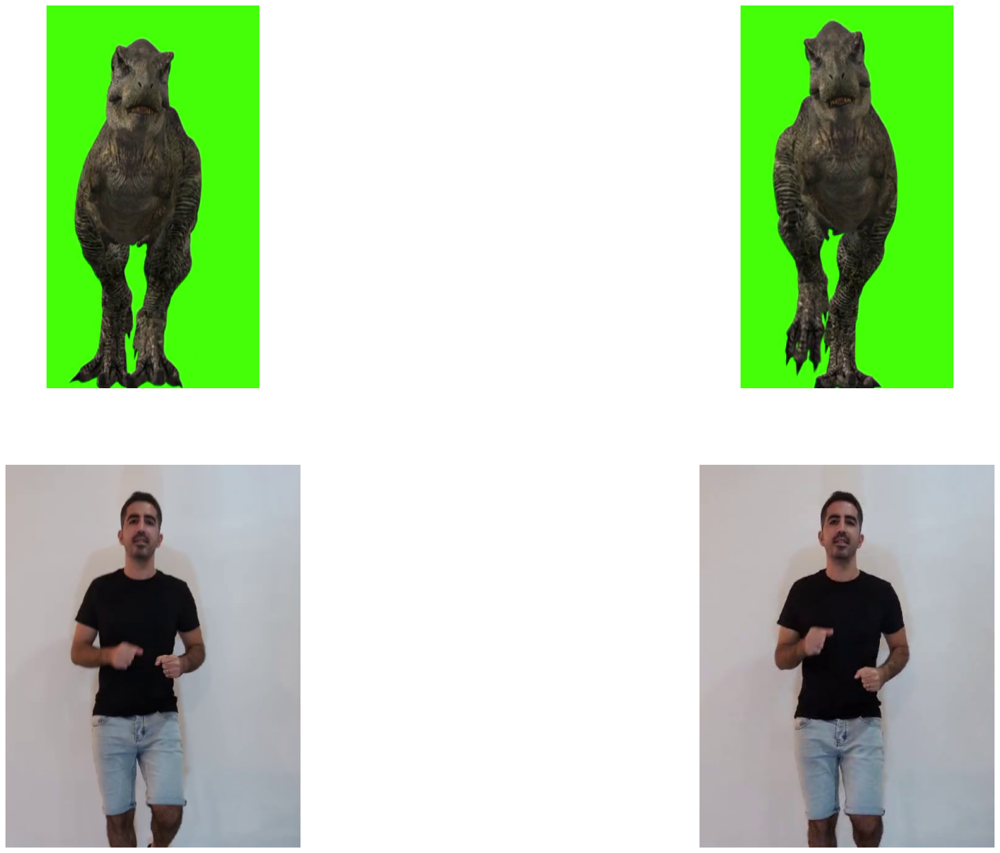

In [ ]:
plt.figure(figsize=(30,20))
plt.subplot(2,2,1)
plt.imshow(cv2.cvtColor(dino_frames_cut[300], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(cv2.cvtColor(dino_frames_cut[400], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(cv2.cvtColor(my_frames_cut[300], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(cv2.cvtColor(my_frames_cut[400], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')

In [ ]:
masks_dino = frames_to_masks_dino(dino_frames)
masks_dino = cut_dino_frames(masks_dino)
masks_oron = frames_to_masks_oron(my_frames_cut)

c:\work\CV\046746---Algorithms-and-Applications-in-Computer-Vision\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\work\CV\046746---Algorithms-and-Applications-in-Computer-Vision\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\work\CV\046746---Algorithms-and-Applications-in-Computer-Vision\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (1) found smaller than n_clusters (2). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\work\CV\046746---Algorithms-and-Applications-in-Computer-Vision\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number

Segmenting image #100 with 2 clusters
Segmenting image #200 with 2 clusters
Segmenting image #300 with 2 clusters
Segmenting image #400 with 2 clusters
Segmenting image #500 with 2 clusters
Segmenting image #600 with 2 clusters
Segmenting image #700 with 2 clusters
Segmenting image #800 with 2 clusters
Segmenting image #900 with 2 clusters
Segmenting image #1000 with 2 clusters
Segmenting image #1100 with 2 clusters
Segmenting image #1200 with 2 clusters
Segmenting image #1300 with 2 clusters
Segmenting image #100 with 3 clusters
Segmenting image #200 with 3 clusters
Segmenting image #300 with 3 clusters
Segmenting image #400 with 3 clusters
Segmenting image #500 with 3 clusters
Segmenting image #600 with 3 clusters


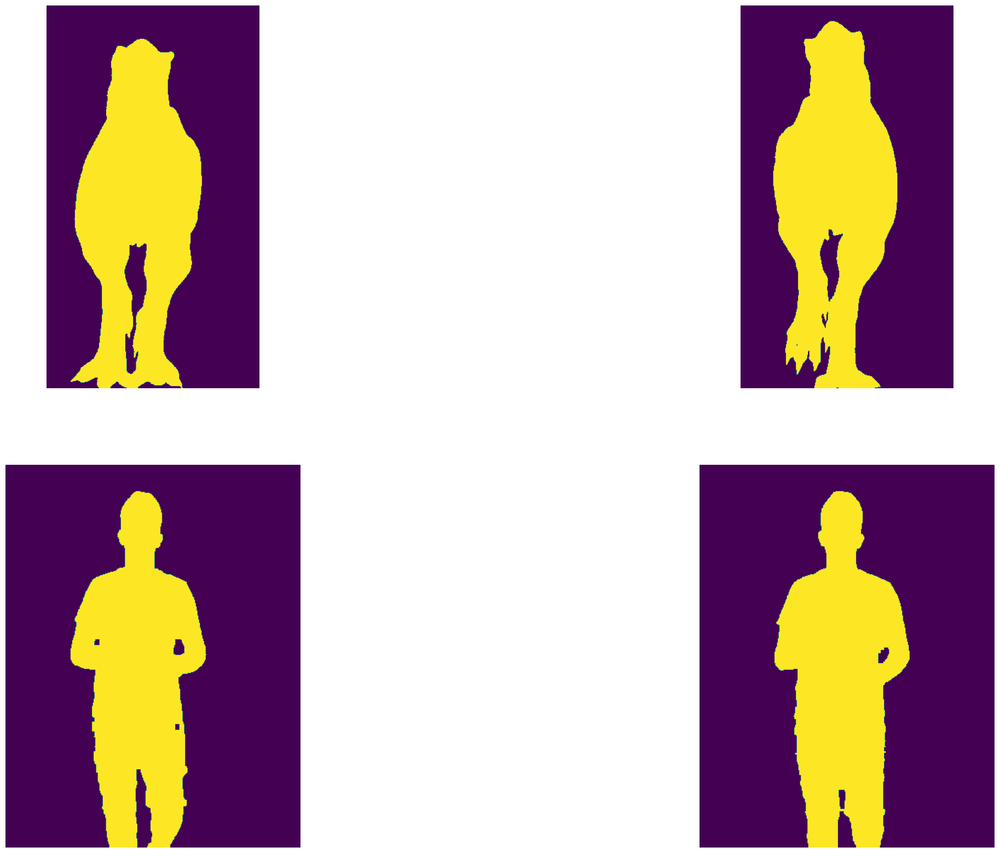

In [ ]:
plt.figure(figsize=(30,20))
plt.subplot(2,2,1)
plt.imshow(masks_dino[300])
_ = plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(masks_dino[400])
_ = plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(masks_oron[300])
_ = plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(masks_oron[400])
_ = plt.axis('off')

Improving Oron's masks quality

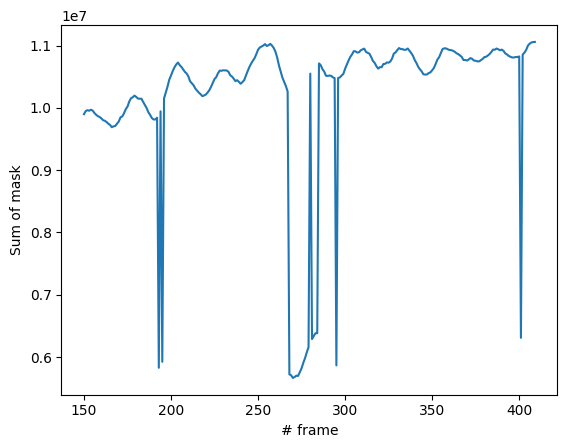

In [ ]:
plt.plot(range(150,410),np.array(masks_oron[150:410]).sum(axis=(1,2)))
plt.xlabel('# frame')
plt.ylabel('Sum of mask')
plt.show()

In [ ]:
masks_oron_2 = frames_to_masks_oron(my_frames_cut, improve = True)

Segmenting image #100 with 3 clusters
Segmenting image #200 with 3 clusters
Segmenting image #300 with 3 clusters
Segmenting image #400 with 3 clusters
Segmenting image #500 with 3 clusters
Segmenting image #600 with 3 clusters


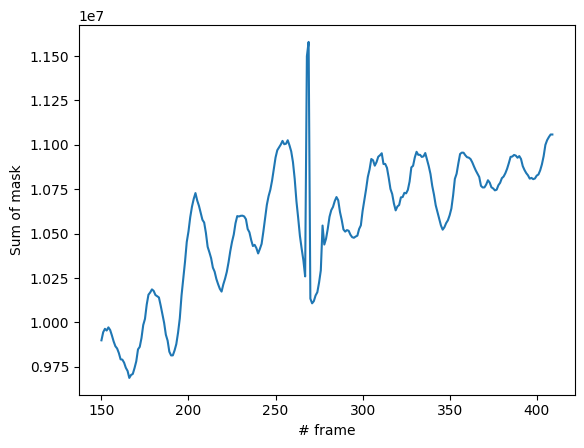

In [ ]:
plt.plot(range(150,410), np.array(masks_oron_2[150:410]).sum(axis=(1,2)))
plt.xlabel('# frame')
plt.ylabel('Sum of mask')
plt.show()

In [ ]:
def mask_frame(frames, masks):
    frames_masked = []
    for (frame,mask) in zip(frames,masks):
        mask[mask == 255] = 1
        masked_frame = frame * cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR) 
        frames_masked.append(masked_frame)
    return frames_masked

dino_frames_masked = mask_frame(dino_frames_cut, masks_dino)
my_frames_masked = mask_frame(my_frames_cut, masks_oron_2)

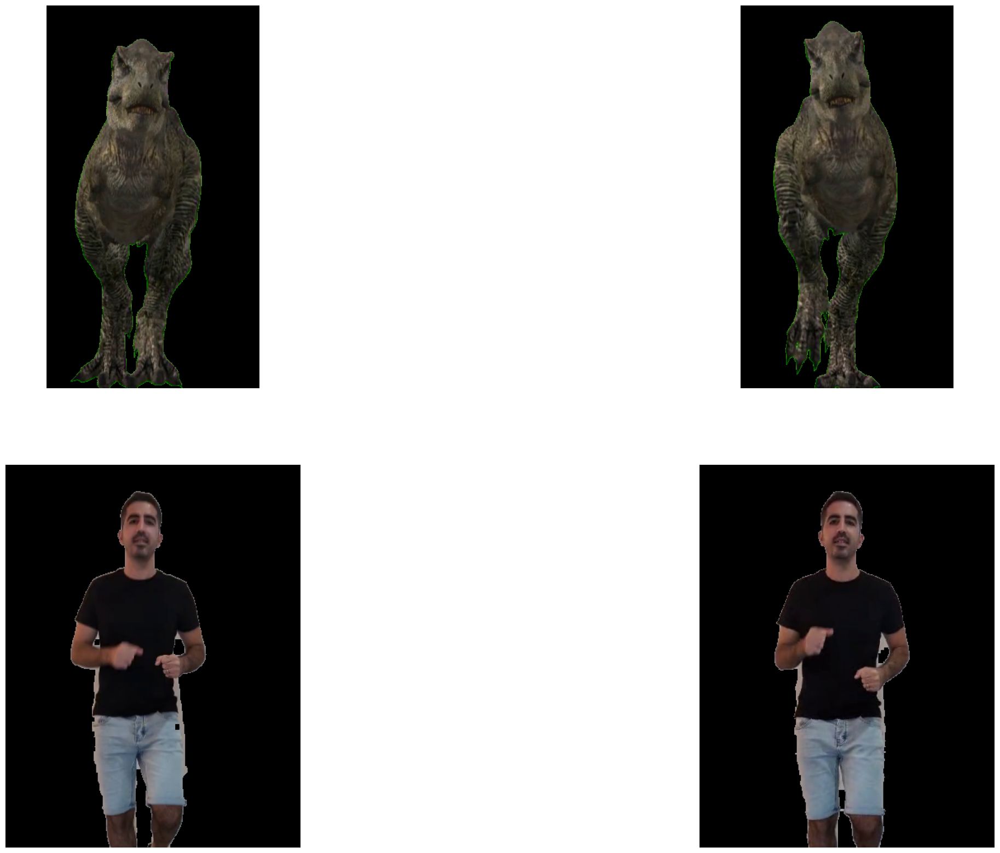

In [ ]:
plt.figure(figsize=(30,20))
plt.subplot(2,2,1)
plt.imshow(cv2.cvtColor(dino_frames_masked[300], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(cv2.cvtColor(dino_frames_masked[400], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(cv2.cvtColor(my_frames_masked[300], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(cv2.cvtColor(my_frames_masked[400], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')

In [ ]:
image_list_to_video(my_frames_masked[150:460],r'..\output\my_vid_mask.mp4')
image_list_to_video(dino_frames_masked[270:530],r'..\output\dino_vid_mask.mp4')

In [ ]:
def locate_obj_and_expand(obj, H, W, w_loc):
    if H > obj.shape[0]:
        obj = np.concatenate((np.zeros((H - obj.shape[0], obj.shape[1], obj.shape[2]), dtype=np.uint8),obj))
    center_pix = int(W * w_loc)
    obj = np.concatenate((np.zeros((obj.shape[0], center_pix - np.uint8(obj.shape[1]/2) , obj.shape[2]), dtype=np.uint8),obj), axis=1)
    obj = np.concatenate((obj,np.zeros((obj.shape[0], W - obj.shape[1], obj.shape[2]), dtype=np.uint8)), axis=1)
    return obj

def stitching_video(my_frames_masked, masks_oron, dino_frames_masked, masks_dino):
    frames_stitched = []
    bgd = cv2.imread(r'..\data\background\moon.jpg')
    (H,W,_) = bgd.shape
    for (obj1,obj1_mask,obj2,obj2_mask) in zip(my_frames_masked, masks_oron, dino_frames_masked, masks_dino):
        obj1 = locate_obj_and_expand(obj1, H, W, 0.3)
        obj1_mask = locate_obj_and_expand(cv2.cvtColor(obj1_mask, cv2.COLOR_GRAY2BGR) , H, W, 0.3)
        obj2 = locate_obj_and_expand(obj2, H, W, 0.7)
        obj2_mask = locate_obj_and_expand(cv2.cvtColor(obj2_mask, cv2.COLOR_GRAY2BGR), H, W, 0.7)
        frame = bgd * (1 - obj1_mask) * (1 - obj2_mask) + obj1 + obj2
        frames_stitched.append(frame)
    return frames_stitched

frames_stitched = stitching_video(my_frames_masked[150:410], masks_oron_2[150:410], dino_frames_masked[270:530], masks_dino[270:530])


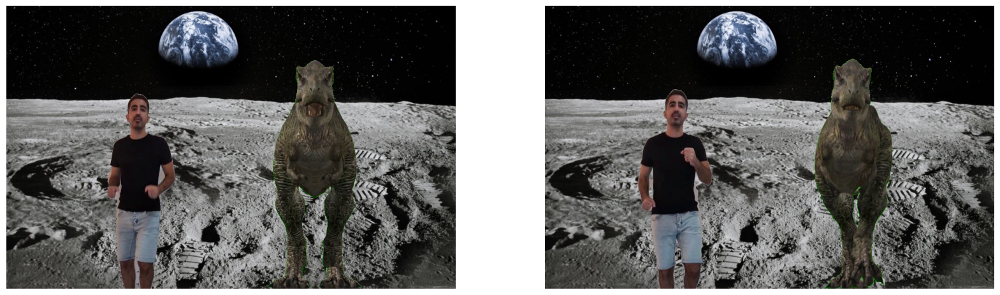

In [ ]:
plt.figure(figsize=(20,40))
plt.subplot(1,2,1)
plt.imshow(cv2.cvtColor(frames_stitched[0], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(cv2.cvtColor(frames_stitched[100], cv2.COLOR_BGR2RGB))
_ = plt.axis('off')
plt.show()

In [ ]:
image_list_to_video(frames_stitched,r'..\output\combined_video.mp4')


#### Part 3 - Planar Homographies: 
---
After we saw how descriptors are implemented and performed, now we will see how to use them for homographis.

In this part you will implement an image stitching algorithm, and will learn how to stitch several images of the same scene into a panorama. First, we’ll concentrate on the case of two images and then extend to several images.

For the following tasks:
- **You are not allowed to use OpenCV/Scipy or any other "ready to use" functions when you are asked to implement a function (you can still use the functions to save and load images).**
- For each step add illustration images to your report.
- You can demonstrate your steps using `incline_L.jpg` and `incline_R.jpg` images, or any other relevant example images (unless specified otherwise).

#### Planar Homographies: Theory review
---
Suppose we have two cameras $C_1$ and $C_2$ looking at a common plane $Π$ in 3D space. Any 3D point $P$ on $Π$ generates a projected 2D point located at $p ≡ (x,y,1)^T$ on the ﬁrst camera $C_1$ and $q ≡ (u,v,1)^T$ on the second camera $C_2$. Since $P$ is conﬁned to the plane $Π$, we expect that there is a relationship between $p$ and $q$. In particular, there exists a common $3 × 3$ matrix $H$, so that for any $P$, the following conditions holds: 
\begin{align}
\text{(1) }q ≡ Hp
\end{align}



We call this relationship *'planar homography'*. Recall that both $p$ and $q$ are in homogeneous coordinates and the equality $≡$ means $p$ is proportional to $Hq$ (recall homogeneous coordinates). It turns out this relationship is also true for cameras that are related by pure rotation without the planar constraint. 

##### **Matched points:**
---

Given a set of points $p = \{p_1,p_2,...,p_N\}$ in an image taken by camera $C_1$ and corresponding points $q = \{q_1,q_2,...,q_N\}$ in an image taken by $C_2$. Suppose we know there exists an unknown homography $H$ between corresponding points for all $i ∈\{1,2,...,N\}$. This formally means that $\exists H$ such that: 

 
\begin{equation*} 
\text{(2) } q^i ≡ Hp^i
\end{equation*}


where $p^i = (x_i,y_i,1)$ and $q^i = (u_i,v_i,1)$ are homogeneous coordinates of image points each from an image taken with $C_1$ and $C_2$ respectively.

* Given $N$ correspondences in $p$ and $q$ and using Equation 2, we derived a set of $2N$ independent linear equations in the form:


\begin{equation*} 
\text{(3) } Ah = 0
\end{equation*}


where $h$ is a vector of the elements of $H$ and $A$ is a matrix composed of elements derived from the point coordinates:  

$$ \begin{bmatrix} &&&&&\dots\\ x_i & y_i & 1 & 0 & 0 & 0 & -x_iu_i&-y_iu_i& -u_i \\ 0&0&0&x_i&y_i&1 & -x_iv_i&-y_iv_i& -v_i \\ &&&&&\dots \end{bmatrix} 
\begin{bmatrix} h_1\\h_2\\h_3\\ h_4 \\ h_5 \\ h_6 \\ h_7\\h_8\\h_9\\ \end{bmatrix} = \begin{bmatrix} \dots \\ 0 \\ 0  \\ \dots \end{bmatrix}$$


Each point pair contributes 2 equations and therefore we need at least 4 matches.

#### Planar Homographies: Practice 
---

#### Quick detour- Feature Descriptor
---
In this part we are going to use **Scale-Invariant Feature Transform** (SIFT). We will use OpenCV <a href="https://docs.opencv.org/3.4/db/d27/tutorial_py_table_of_contents_feature2d.html">[2]</a> for the implementation.

##### 3.0.1 SIFT Implementaion
---
Implement the following function:


In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import RegularGridInterpolator

In [14]:
def SIFT_descriptor(img):
    # Returns the SIFT descriptor keypoints of an image and draws its detected keypoints
    # Black pixel filter is applied to exclude matching keypoints on black areas
    # INPUTS
    #      img                 - An image read by cv2.imread()
    # OUTPUTS
    #      sift_descriptor     - The SIFT descriptor computed by OpenCV
    #      sift_keypoints      - The SIFT keypoints computed by OpenCV

    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Create a binary mask by thresholding the grayscale image
    _, mask = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)

    # Instantiate the SIFT detector
    sift = cv2.xfeatures2d.SIFT_create()

    # Detect and compute SIFT keypoints and descriptors
    sift_keypoints, sift_descriptor = sift.detectAndCompute(img, mask)

    # Draw keypoints on the image
    img_with_keypoints = cv2.drawKeypoints(img, sift_keypoints, None)

    # Convert the image from BGR to RGB for displaying with matplotlib
    img_with_keypoints_rgb = cv2.cvtColor(img_with_keypoints, cv2.COLOR_BGR2RGB)

    # Show the image with keypoints
    plt.imshow(img_with_keypoints_rgb)
    plt.axis('off')
    plt.show()

    # Return the SIFT descriptor and keypoints
    return sift_keypoints, sift_descriptor

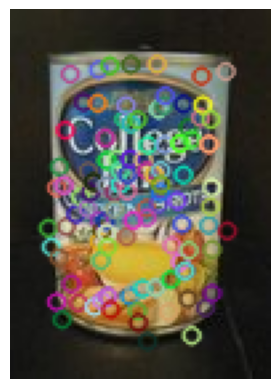

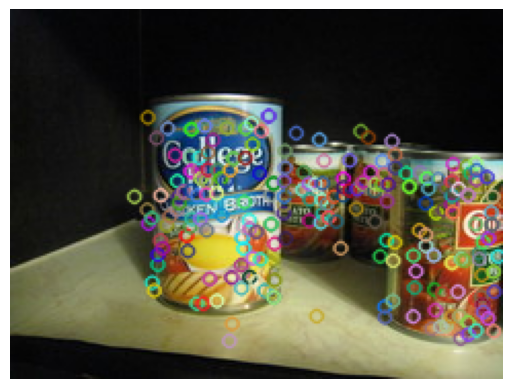

In [ ]:
# Load the images
model_chickenbroth_img = cv2.imread(r'../data/chickenbroth/model_chickenbroth.jpg')
chickenbroth_img = cv2.imread(r'../data/chickenbroth/chickenbroth_01.jpg')

# Call the SIFT_descriptor function for model_chickenbroth image
model_sift_descriptor, model_sift_keypoints = SIFT_descriptor(model_chickenbroth_img)

# Call the SIFT_descriptor function for chickenbroth image
sift_descriptor, sift_keypoints = SIFT_descriptor(chickenbroth_img)

The function get an image ,returns its SIFT descriptor and keypoints, and draw the detected keypoints over the image.

Plot the results obtained for the `model_chickenbroth` image and another `chickenbroth` image (Use the same image from previous section).


* Implementaton guidance:
    * Use `sift = cv2.xfeatures2d.SIFT_create()` to instantiate the SIFT detector. 
    * Detect and compute SIFT keypoints and descriptors by `sift_keypoint, sift_descriptor = sift.detectAndCompute(img,None)`.
    * Draw the keypoints over the image by using `cv2.drawKeypoints()`.


##### 3.1 - Finding corresponding points using SIFT: 
---
Use the guidelines from 3.0.1 and implement the function `getPoints_SIFT()`, which gets two images and outputs `p1,p2` SIFT keypoints, where `p1[j],p2[j]` are pairs of cooresponding points between `im1` and `im2`.

In [9]:
def getPoints_SIFT(im1, im2):
    # Get SIFT descriptors and keypoints for both images
    keypoints1, descriptors1 = SIFT_descriptor(im1)
    keypoints2, descriptors2 = SIFT_descriptor(im2)

    # Match keypoints using a brute-force matcher
    matcher = cv2.BFMatcher(cv2.NORM_L2)
    matches = matcher.match(descriptors1, descriptors2)

    # Sort the matches by distance
    matches = sorted(matches, key=lambda x: x.distance)

    # Keep only the top matches
    num_matches = min(10, len(matches))
    matches = matches[:num_matches]

    # Get the points
    p1 = np.zeros((2,len(matches)))
    p2 = np.zeros((2,len(matches)))

    for i in range(len(matches)):
        p1[:,i] = keypoints1[matches[i].queryIdx].pt
        p2[:,i] = keypoints2[matches[i].trainIdx].pt

    # Draw the best matches on the images
    matched_image = cv2.drawMatches(im1, keypoints1, im2, keypoints2, matches, None)

    # Convert the image from BGR to RGB for displaying with matplotlib
    matched_image_rgb = cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB)

    # Show the images with matches
    plt.imshow(matched_image_rgb)
    plt.axis('off')
    plt.show()

    # Return the corresponding keypoints
    return p1, p2

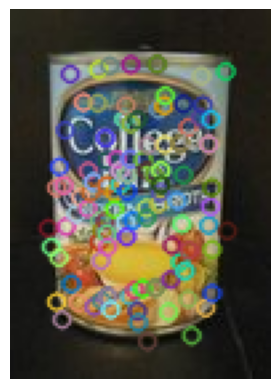

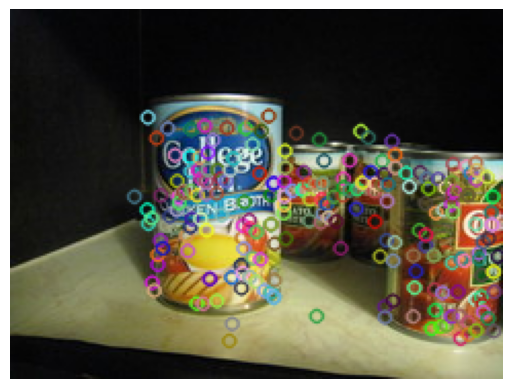

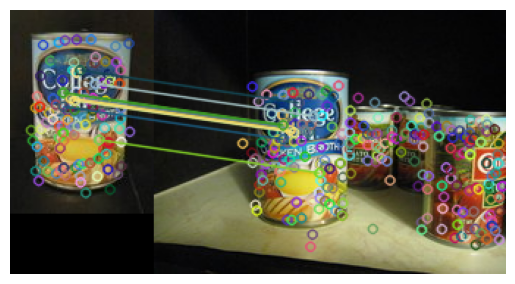

In [ ]:
# Load the images
im1 = cv2.imread(r'../data/chickenbroth/model_chickenbroth.jpg')
im2 = cv2.imread(r'../data/chickenbroth/chickenbroth_01.jpg')

# Call the getPoints_SIFT() function
p1, p2 = getPoints_SIFT(im1, im2)

Inputs: `im1` and `im2` are two 2D grayscale images. 

Output: `p1` and `p2` should be $2\times N$ matrices of corresponding $(x,y)^T$ coordinates between two images ($N$ is the number of corrosponding points you want to extract.). 

* You can also use color images instead of grayscale images, just state it in the report.

#### 3.2 - Calculate transformation: 
---

Implement a function that gets a set of matching points between two images and calculates the transformation between them. The transformation should be $3\times3$ $H$ homogenous matrix such that for each point in image $p\in C_1$, there would be a transformation in image $C_2$ such that $p=Hq$, $q\in C_2$.

In [10]:
def computeH(p1, p2):

    # Get number of points
    N = p1.shape[1]

    # Create the coefficient matrix
    A = np.zeros((2*N,9))
    for i in range(N):
        x, y = p2[0,i], p2[1,i]
        u, v = p1[0,i], p1[1,i]
        A[2*i,:] = np.array([-x, -y, -1, 0, 0, 0, u*x, u*y, u])
        A[2*i+1,:] = np.array([0, 0, 0, -x, -y, -1, v*x, v*y, v])

    # Perform singular value decomposition (SVD) of A
    _, _, V = np.linalg.svd(A)

    # Extract the homography matrix from the right nullspace of A
    H = V[-1].reshape(3, 3)

    # Normalize the homography matrix
    H /= H[2, 2]

    print("Computed Transformation Matrix H:")
    print(H)

    return H

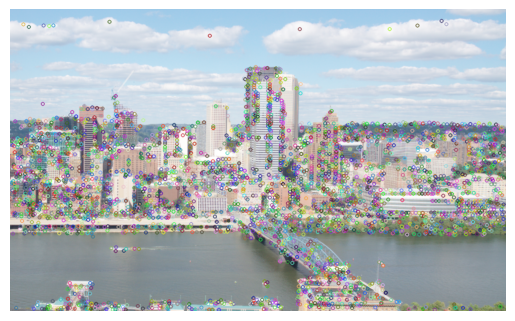

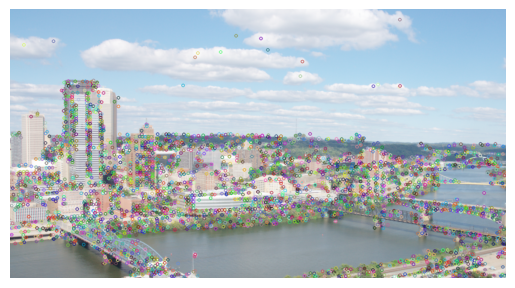

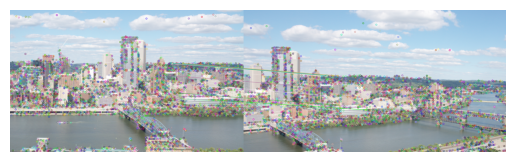

Computed Transformation Matrix H:
[[ 6.43214068e-01  1.81266591e-03  3.61573051e+02]
 [-8.53901604e-02  9.01142323e-01 -2.05006210e+01]
 [-3.75351045e-04  3.69444839e-05  1.00000000e+00]]


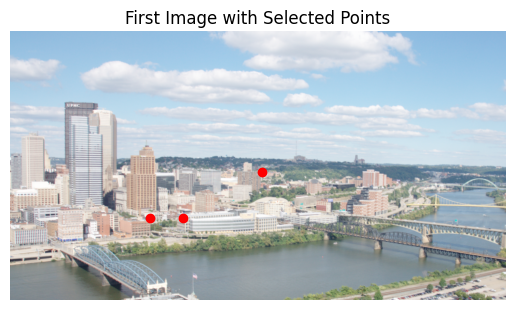

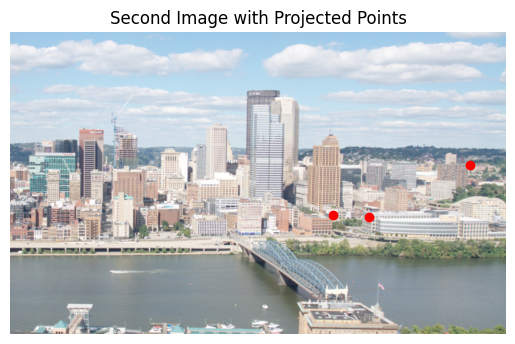

In [ ]:
# Example usage:
im1 = cv2.imread(r'../data/incline_L.png')
im2 = cv2.imread(r'../data/incline_R.png')
p1, p2 = getPoints_SIFT(im1, im2)
H = computeH(p1, p2)  # Compute homography matrix

# Select arbitrary points in the first image
selected_points = [[300, 400], [540, 300], [370, 400]]  # Example points

# Convert the points to homogeneous coordinates
selected_points_homogeneous = np.array([[point[0], point[1], 1] for point in selected_points]).T

# Project the points to the second image using the homography matrix
projected_points_homogeneous = np.dot(H, selected_points_homogeneous)
projected_points = (projected_points_homogeneous[:2] / projected_points_homogeneous[2]).T

# Display the first image with the selected points
plt.imshow(cv2.cvtColor(im2, cv2.COLOR_BGR2RGB))
plt.plot([point[0] for point in selected_points], [point[1] for point in selected_points], 'ro')
plt.axis('off')
plt.title('First Image with Selected Points')
plt.show()

# Display the second image with the projected points
plt.imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB))
plt.plot([point[0] for point in projected_points], [point[1] for point in projected_points], 'ro')
plt.axis('off')
plt.title('Second Image with Projected Points')
plt.show()

Inputs: `p1` and `p2` should be $2\times N$ matrices of corresponding $(x,y)^T$ coordinates between two images. 

Outputs: `H2to1` should be a $3\times 3$ matrix encoding the homography that best matches the linear equation derived above for Equation 2. 

Hint: Remember that a homography is only determined up to scale. The `numpy`'s functions `eig()` or `svd()` will be useful. Note that this function can be written without an explicit for-loop over the data points.

*Hint for debugging*: A good test of your code is to check that the homography of an image with itself is an identity.

* Implement the computation function, describe and explain your implementation.
* Show that the transformation is correct by selecting arbitrary points in the first image and projecting them to the second image.

#### 3.3 - Image warping:
---
Implement a function that gets an input image and a transformation matrix H and returns the warped image. Please note that after the warping, there will be coordinates that won’t be integers (e.g. sub-pixels). Therefore you will need to interpolate between neighboring pixels. For color images, warp the image for each color channel and then connect them together. In order to avoid holes, use inverse warping.

Implement the wrapping function using numpy and SciPy interp2d() or RegularGridInterpolator() function .
Discuss the influences of different interpolations kinds {‘linear’, ‘cubic’}.
Note: When performing a multi-step algorithm, you need to demonstrate and explain each of those additional improvments.


In [11]:
def warpH(im1, H, out_size):
    # Get input image dimensions
    imH, imW = im1.shape[0], im1.shape[1]
    points = (np.arange(imH), np.arange(imW))

    # Create meshgrid for output coordinates
    y_out, x_out = np.mgrid[0:out_size[0], 0:out_size[1]]

    # Convert output coordinates to homogeneous coordinates
    coords_out = np.stack((x_out, y_out, np.ones_like(x_out)), axis=-1)

    # Compute inverse transformation of output coordinates using H
    coords_in = np.matmul(np.linalg.inv(H), coords_out.reshape(-1, 3).T).T

    # Convert homogeneous coordinates to Cartesian coordinates
    x_in = coords_in[:, 0] / coords_in[:, 2]
    y_in = coords_in[:, 1] / coords_in[:, 2]

    # Reshape input coordinates to match output grid
    x_in = x_in.reshape(out_size)
    y_in = y_in.reshape(out_size)

    # Initialize warped image with zeros
    warp_im = np.zeros((out_size[0], out_size[1], im1.shape[2]), dtype=np.uint8)

    # Warp each color channel separately
    for channel in range(im1.shape[2]):
        # Create RegularGridInterpolator using input image channel
        interpolator = RegularGridInterpolator((np.arange(imH), np.arange(imW)), im1[:, :, channel], method='linear', bounds_error=False, fill_value=0)

        # Interpolate input image channel at warped coordinates
        warp_im[:, :, channel] = interpolator((y_in, x_in))

    return warp_im

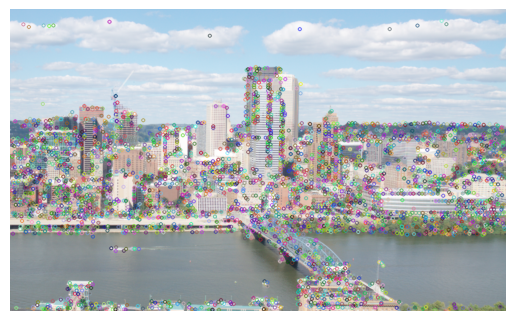

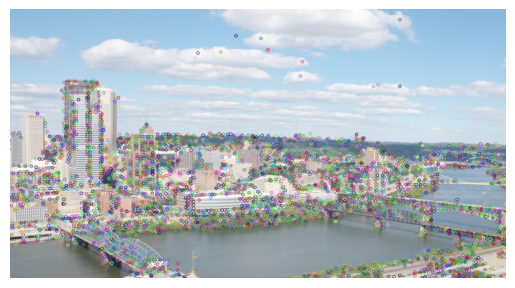

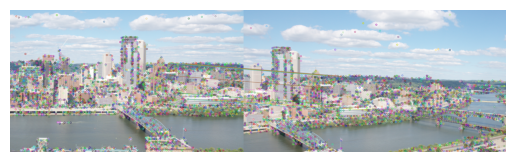

Computed Transformation Matrix H:
[[ 6.43214068e-01  1.81266591e-03  3.61573051e+02]
 [-8.53901604e-02  9.01142323e-01 -2.05006210e+01]
 [-3.75351045e-04  3.69444839e-05  1.00000000e+00]]


In [ ]:
# Load the images
im1 = cv2.imread(r'../data/incline_L.png')
im2 = cv2.imread(r'../data/incline_R.png')

# Call the getPoints_SIFT() function
p1, p2 = getPoints_SIFT(im1, im2)

# Define the transformation matrix
H = computeH(p1, p2)

# Set the output size for the warped image
out_size = (im2.shape[0], im2.shape[1] + im1.shape[1])

# Warp the image
warp_im2 = warpH(im2, H, out_size)

Inputs: `im1` is a colored image. `H` is a  matrix encoding the homography between im1 and im2. `out_size` is the size of the wanted output (new_imH,new_imW).

Output: `warp_im1` is the warped image im1 including empty background (zeros).

##### 3.4 - Panorama stitching: 
---
Implement a function that gets two images after axis alignment (using OpenCV's `warpPerspective`)
and returns a union of the two. The union should be a simple overlay of one image on the other. Leave empty pixels painted black.


In [12]:
def imageStitching(im1, warp_im2, warped_side):

    # Take the larger Image and create from it the panorama image
    if warped_side == 'left':
        pano_img = im1
        pano_img[:warp_im2.shape[0], -warp_im2.shape[1]:] = warp_im2

    elif warped_side == 'right':
        pano_img = warp_im2
        pano_img[:im1.shape[0],:im1.shape[1],:] = im1

    # Crop the black border
    gray = cv2.cvtColor(pano_img, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    x, y, w, h = cv2.boundingRect(contours[0])
    pano_img = pano_img[y:y + h, x:x + w]

    # Print the warped image
    plt.imshow(cv2.cvtColor(pano_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    return pano_img

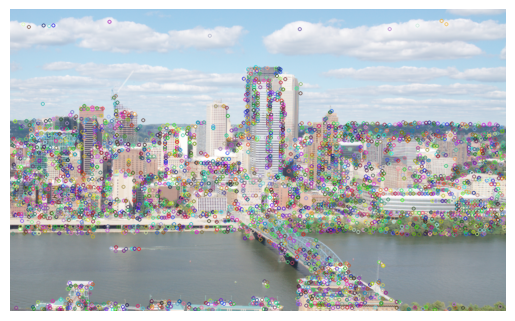

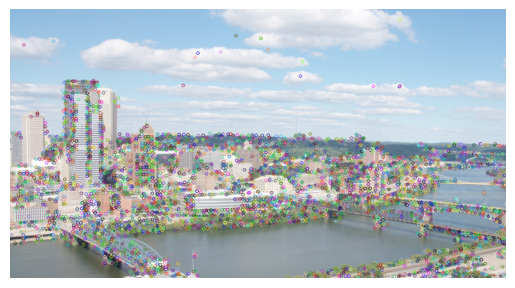

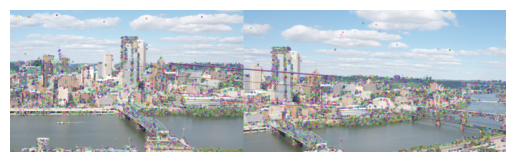

Computed Transformation Matrix H:
[[ 6.43214068e-01  1.81266591e-03  3.61573051e+02]
 [-8.53901604e-02  9.01142323e-01 -2.05006210e+01]
 [-3.75351045e-04  3.69444839e-05  1.00000000e+00]]


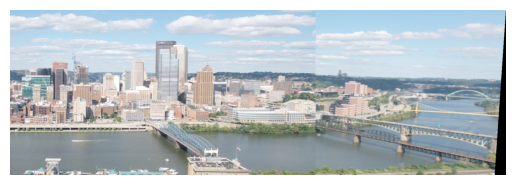

array([[[229, 199, 159],
        [229, 199, 157],
        [230, 198, 158],
        ...,
        [225, 209, 196],
        [225, 209, 197],
        [225, 209, 196]],

       [[230, 199, 156],
        [230, 199, 158],
        [230, 199, 158],
        ...,
        [223, 206, 193],
        [223, 206, 193],
        [223, 206, 192]],

       [[230, 199, 160],
        [231, 198, 160],
        [230, 198, 160],
        ...,
        [223, 205, 190],
        [222, 204, 190],
        [222, 203, 189]],

       ...,

       [[133, 130, 130],
        [133, 131, 128],
        [133, 130, 127],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[137, 135, 130],
        [136, 134, 130],
        [137, 134, 131],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[144, 140, 136],
        [142, 139, 138],
        [143, 140, 139],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]

In [ ]:
# Load the images
im1 = cv2.imread(r'../data/incline_L.png')
im2 = cv2.imread(r'../data/incline_R.png')

# Call the getPoints_SIFT() function
p1, p2 = getPoints_SIFT(im1, im2)

# Define the transformation matrix
H = computeH(p1, p2)

# Set the output size for the warped image and resize im1 to match the size of im2
im1 = cv2.resize(im1, (im2.shape[1], im2.shape[0]))
out_size = (im2.shape[0], im2.shape[1] + im1.shape[1])

# Warp the image
warp_im2 = warpH(im2, H, out_size)

pano_img = imageStitching(im1, warp_im2, warped_side='right')

Inputs: `im1`,`warp_img2` are two colored images. 

Output: `panoImg` is the gathered output  panorama.

* Use all the above functions to create a panorama image. Demonstrate and explain you results on the `./data/incline` images.

##### 3.5 - Several Images stitching:
---
* Show the results of the panoramas on the attached images of the beach (`./data/beach`) and Pena National Sintra Palace (`./data/sintra`) for the entire set of images.

* Note: When using SIFT without RANSAC (next section), take the top K matches for estimating the homography. 
  * What happens if you don't do so? Why is that?

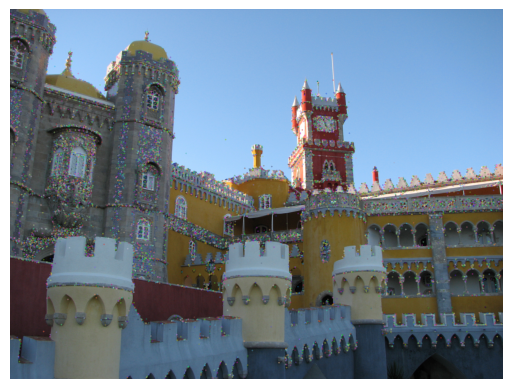

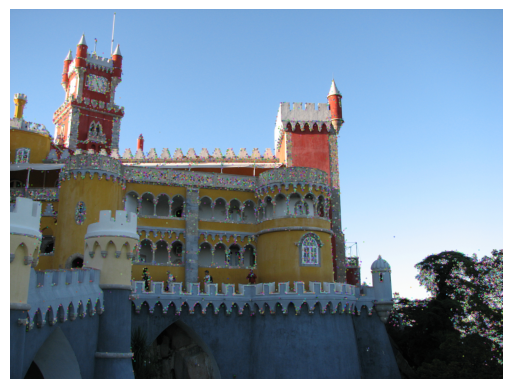

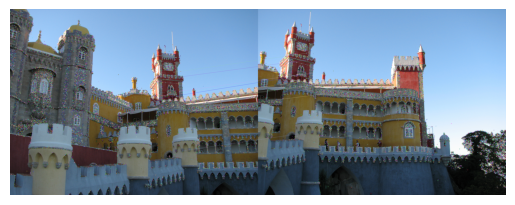

Computed Transformation Matrix H:
[[ 7.57559741e-01  8.98711594e-02  1.29885478e+03]
 [-2.03823063e-01  9.09376892e-01  3.35820081e+02]
 [-8.47176787e-05 -1.40306290e-05  1.00000000e+00]]


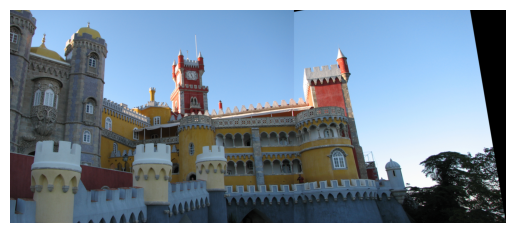

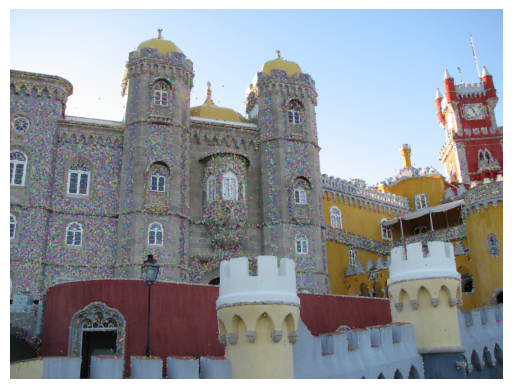

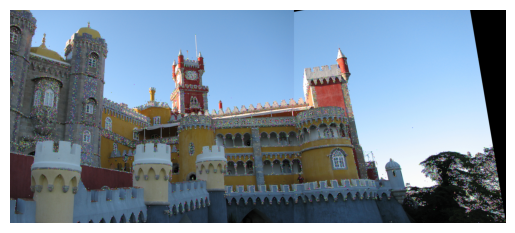

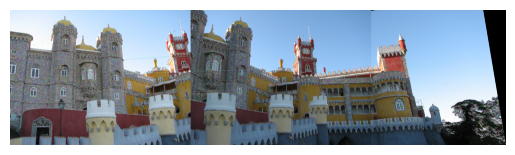

Computed Transformation Matrix H:
[[ 8.66091715e-01  1.22804384e-01  7.92528362e+02]
 [-1.74181109e-01  9.50572394e-01  2.30126252e+02]
 [-4.74577449e-05  1.15019618e-06  1.00000000e+00]]


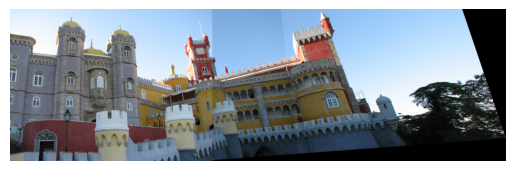

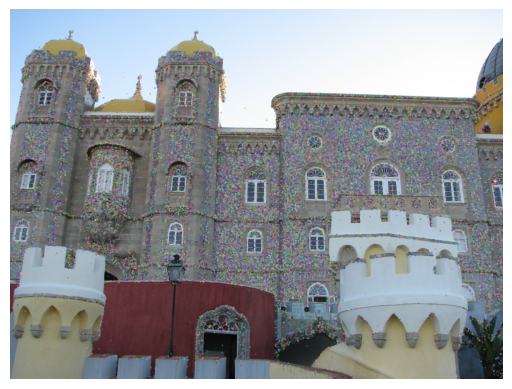

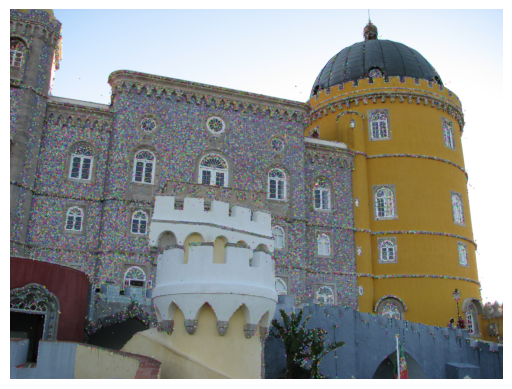

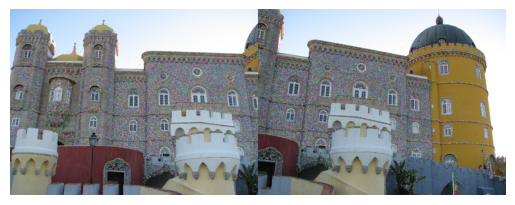

Computed Transformation Matrix H:
[[ 8.06185987e-01  8.60197531e-02  9.47376253e+02]
 [-1.66781602e-01  9.09570579e-01  2.48961416e+02]
 [-6.00980571e-05 -1.45338361e-05  1.00000000e+00]]


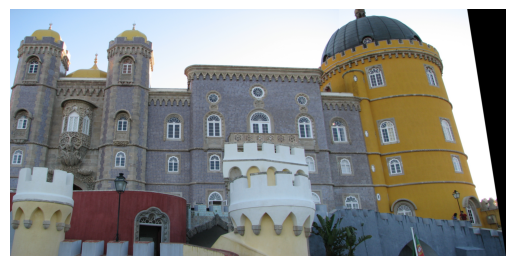

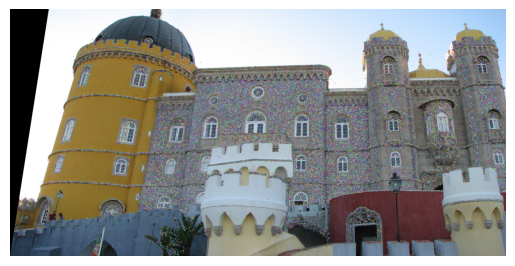

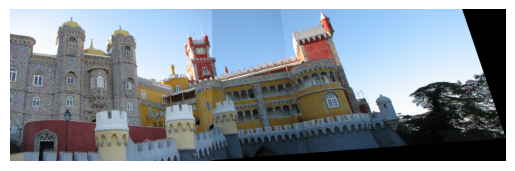

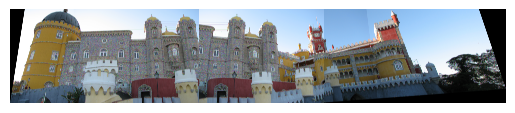

Computed Transformation Matrix H:
[[ 7.20204924e-01  1.12842687e-01  2.37749326e+03]
 [-1.70947685e-01  9.32510747e-01  1.56280713e+02]
 [-6.53817721e-05 -1.35637105e-06  1.00000000e+00]]


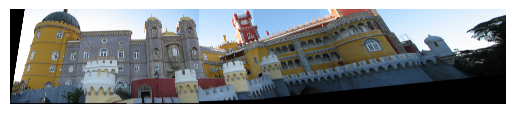

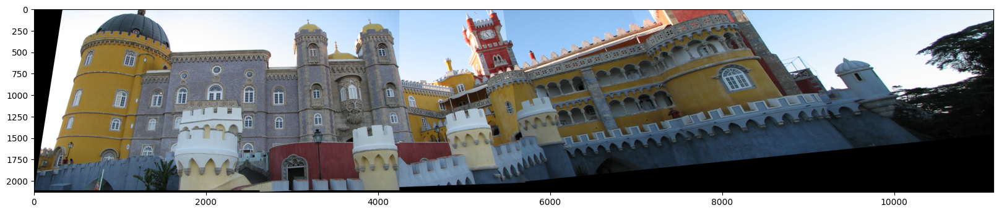

In [ ]:
# Load the images
im1 = cv2.imread(r'../data/sintra/sintra1.JPG')
im2 = cv2.imread(r'../data/sintra/sintra2.JPG')
im3 = cv2.imread(r'../data/sintra/sintra3.JPG')
im4 = cv2.imread(r'../data/sintra/sintra4.JPG')
im5 = cv2.imread(r'../data/sintra/sintra5.JPG')

images = [im1, im2, im3, im4, im5]

#Image stitching on 1 and 2
p1, p2 = getPoints_SIFT(images[1], images[0])
H = computeH(p1, p2)
out_size = (images[1].shape[1] + images[0].shape[1], images[1].shape[0])
warped1 = cv2.warpPerspective(images[0], H, out_size)
stitched_images21 = imageStitching(images[1], warped1, warped_side='right')

#Image stitching on 21 and 3
p1, p2 = getPoints_SIFT(images[2], stitched_images21)
H = computeH(p1, p2)
out_size = (images[2].shape[1] + stitched_images21.shape[1], images[1].shape[0])
warped21 = cv2.warpPerspective(stitched_images21, H, out_size)
stitched_images321 = imageStitching(images[2], warped21, warped_side='right')

#Image stitching on 4 and 5
p1, p2 = getPoints_SIFT(cv2.flip(images[3],1), cv2.flip(images[4],1))
H = computeH(p1, p2)
out_size = (cv2.flip(images[3],1).shape[1] + cv2.flip(images[4],1).shape[1], cv2.flip(images[3],1).shape[0])
warped5 = cv2.warpPerspective(cv2.flip(images[4],1), H, out_size)
stitched_images54 = imageStitching(cv2.flip(images[3],1), warped5, warped_side='right')

#Image stitching on 321 and 54
p1, p2 = getPoints_SIFT(cv2.flip(stitched_images54,1), stitched_images321)
H = computeH(p1, p2)
out_size = stitched_images54.shape[1] + stitched_images321.shape[1], stitched_images54.shape[0] + stitched_images321.shape[0]
warped54 = cv2.warpPerspective(stitched_images321, H, out_size)
stitched_images54321 = imageStitching(cv2.flip(stitched_images54,1), warped54, warped_side='right')

# Display the Warped image
plt.figure(figsize=(20, 100))
plt.subplot(2, 1, 1)
plt.imshow(cv2.cvtColor(stitched_images54321, cv2.COLOR_BGR2RGB))

In [18]:
# Load the images
im1 = cv2.imread(r'../data/beach/beach5_right.jpg')
im2 = cv2.imread(r'../data/beach/beach4_right.jpg')
im3 = cv2.imread(r'../data/beach/beach3_right.jpg')
im4 = cv2.imread(r'../data/beach/beach2_right.jpg')
im5 = cv2.imread(r'../data/beach/beach1_right.jpg')

# Rotate them 90 degrres counter-clockwise before stitching
beach1_rotated = np.rot90(im1, k=1)
beach2_rotated = np.rot90(im2, k=1)
beach3_rotated = np.rot90(im3, k=1)
beach4_rotated = np.rot90(im4, k=1)
beach5_rotated = np.rot90(im5, k=1)

images = [beach1_rotated, beach2_rotated, beach3_rotated, beach4_rotated, beach5_rotated]

#Image stitching on 1 and 2
p1, p2 = getPoints_SIFT(images[1], images[0])
H = computeH(p1, p2)
out_size = (images[1].shape[1] + images[0].shape[1], images[1].shape[0])
warped1 = cv2.warpPerspective(images[0], H, out_size)
stitched_images21 = imageStitching(images[1], warped1, warped_side='right')

#Image stitching on 21 and 3
p1, p2 = getPoints_SIFT(images[2], stitched_images21)
H = computeH(p1, p2)
out_size = (images[2].shape[2] + stitched_images21.shape[1], images[1].shape[0])
warped21 = cv2.warpPerspective(stitched_images21, H, out_size)
stitched_images321 = imageStitching(images[2], warped21, warped_side='right')

#Image stitching on 4 and 5
p1, p2 = getPoints_SIFT(cv2.flip(images[3],1), cv2.flip(images[4],1))
H = computeH(p1, p2)
out_size = (cv2.flip(images[3],1).shape[1] + cv2.flip(images[4],1).shape[1], cv2.flip(images[3],1).shape[0])
warped5 = cv2.warpPerspective(cv2.flip(images[4],1), H, out_size)
stitched_images54 = imageStitching(cv2.flip(images[3],1), warped5, warped_side='right')

#Image stitching on 321 and 54
p1, p2 = getPoints_SIFT(cv2.flip(stitched_images54,1), stitched_images321)
H = computeH(p1, p2)
out_size = stitched_images54.shape[2] + stitched_images321.shape[1], stitched_images54.shape[0]
warped54 = cv2.warpPerspective(stitched_images321, H, out_size)
stitched_images54321 = imageStitching(cv2.flip(stitched_images54,1), warped54, warped_side='right')

# Display the Warped image
plt.figure(figsize=(20, 10))
plt.subplot(2, 1, 1)
plt.imshow(cv2.cvtColor(np.rot90(stitched_images54321,1), cv2.COLOR_BGR2RGB))

AttributeError: module 'cv2' has no attribute 'xfeatures2d'

##### 3.6 - RANSAC:
---
Added bellow is an implementation of the RANSAC (**Ran**dom **Sa**mple **C**onsensus) algorithm. 
* Explain when it is needed and why.
* Copmare between using RANSAC vs. not using it for creating the panoran images of the beach and SINTRA. Explain.
* What could have been done to get better results?

In [ ]:
def ransacH(p1, p2, nIter=..., tol=...):
    N = p1.shape[1]
    stacked_p2 = np.vstack((p2, np.ones(N)))

    best_inliers_n = 0
    best_inliers = []

    for iter in range(nIter):
        rand_idxs = np.random.choice(np.arange(N), 4, replace=False)
        chosen_p1 = p1[:, rand_idxs]
        chosen_p2 = p2[:, rand_idxs]
        H2to1 = computeH(chosen_p1, chosen_p2)
        p2in1 = H2to1 @ stacked_p2
        p2in1 = p2in1 / p2in1[2, :]
        p2in1 = p2in1[0:2, :]
        L2dists = np.sqrt(np.sum((p2in1 - p1) ** 2, 0))
        inliers = (p1[:, L2dists < tol], p2[:, L2dists < tol])
        n_inliers = np.sum(L2dists < tol)
        if n_inliers > best_inliers_n:
            best_inliers_n = n_inliers
            best_inliers = inliers

    bestH = computeH(best_inliers[0], best_inliers[1])
    return bestH

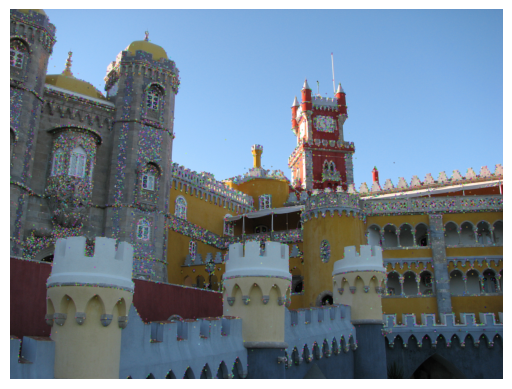

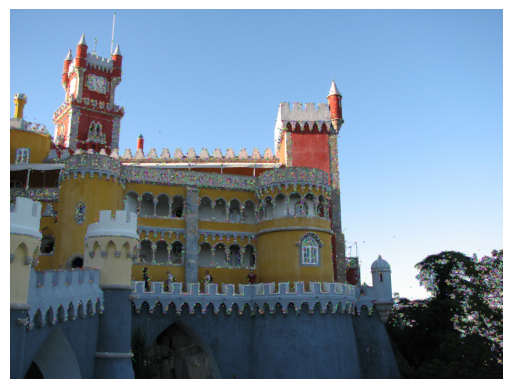

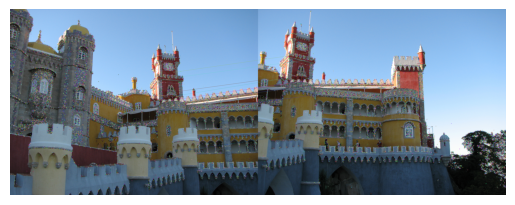

Computed Transformation Matrix H:
[[ 1.04128676e+00  2.33943561e-02  1.25643190e+03]
 [-9.69071824e-02  9.17085305e-01  3.04416436e+02]
 [ 2.82968182e-05 -5.06224337e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.15728983e+00  2.57325054e-01  1.18356950e+03]
 [-5.51913066e-02  1.10655428e+00  2.22204184e+02]
 [ 4.26002245e-05  5.60561118e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.40456751e+00  8.77336602e-02  1.18147176e+03]
 [ 7.46162454e-02  1.01997443e+00  2.19063583e+02]
 [ 1.57003446e-04 -2.32106318e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.45119894e+01 -1.51074401e+00 -8.49160957e+02]
 [ 5.82055288e+00  2.25674067e+00 -1.87347539e+03]
 [ 5.25042439e-03 -9.12971673e-04  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 7.89188133e-01 -1.36301686e-02  1.31144633e+03]
 [-1.69501875e-01  8.39530499e-01  3.43761922e+02]
 [-5.25312229e-05 -7.16695581e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 7.59621939e-01 -4.22785

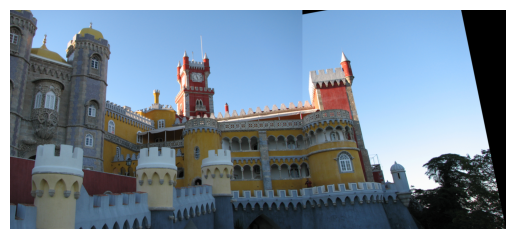

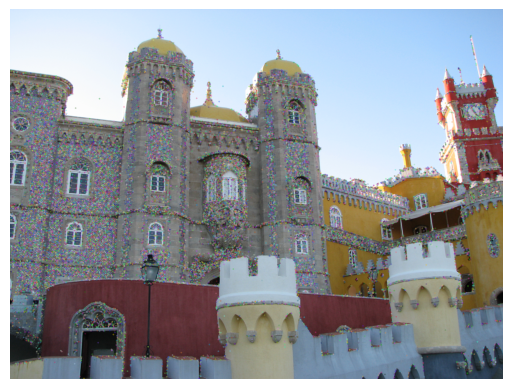

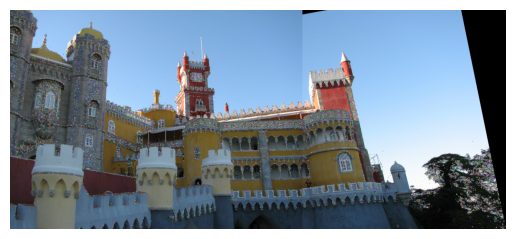

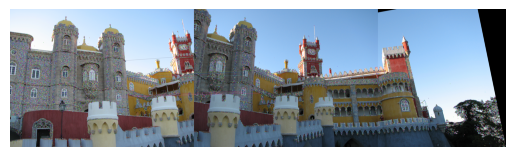

Computed Transformation Matrix H:
[[ 8.37426053e-01  9.57899251e-02  8.14779250e+02]
 [-1.75139755e-01  9.17464784e-01  2.45438813e+02]
 [-5.13277305e-05 -1.25016488e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.60760149e+00 -5.16574844e-01  8.25446356e+02]
 [ 3.02847295e-01  5.35862854e-01  2.53861696e+02]
 [ 4.86923468e-04 -4.34335944e-04  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 7.94458851e-01  7.15551035e-02  8.40391428e+02]
 [-1.87153432e-01  8.81271896e-01  2.69844405e+02]
 [-6.21303263e-05 -2.39132656e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.40222486e+00  4.93489878e-01  5.18972393e+02]
 [-4.52015280e-02  1.53405407e+00 -1.17411818e+02]
 [ 9.13180915e-05  2.04553136e-04  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 8.27546596e-01  1.32378386e-01  7.95163987e+02]
 [-1.99506659e-01  9.50722911e-01  2.37362922e+02]
 [-7.09879184e-05  8.33668418e-06  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 4.82660243e-01  6.03410

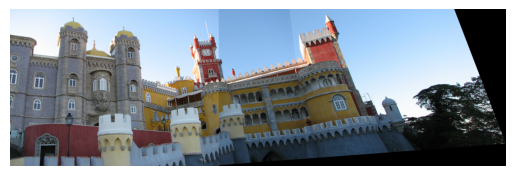

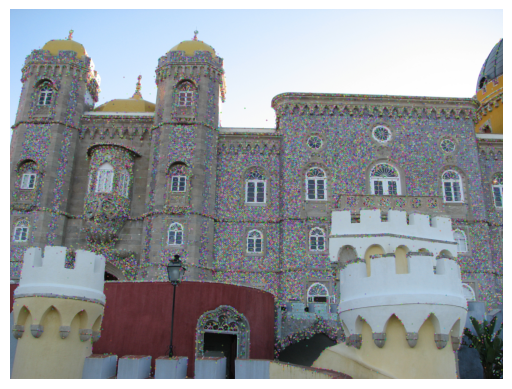

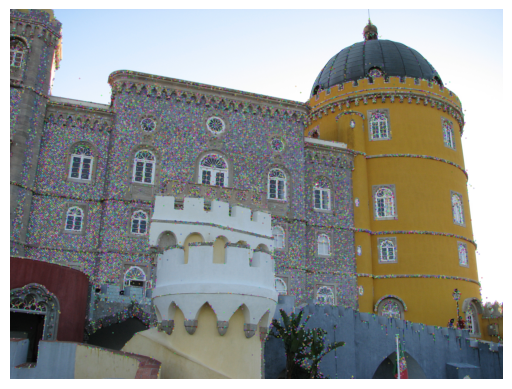

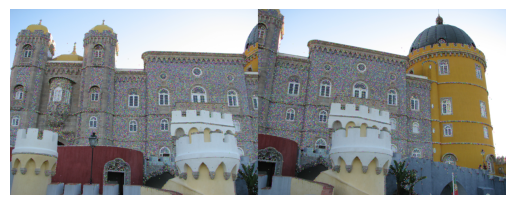

Computed Transformation Matrix H:
[[ 1.22017773e+00  5.10935471e-02  8.21118469e+02]
 [-2.49991637e-02  1.03240627e+00  1.16838569e+02]
 [ 9.20389637e-05 -4.34957822e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 6.53016979e-01 -1.33505575e-01  1.06322969e+03]
 [-1.72278260e-01  7.11910653e-01  3.15008605e+02]
 [-8.42582838e-05 -1.21520960e-04  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 8.05209705e-01  1.16366102e-01  9.40058352e+02]
 [-1.71543958e-01  9.29571661e-01  2.45287762e+02]
 [-6.43685669e-05  1.11470550e-06  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.17879643e+00  5.25292369e-02  8.38332129e+02]
 [-3.52365166e-02  1.01985720e+00  1.26826776e+02]
 [ 7.89582119e-05 -4.19598710e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[-6.82631131e+00  1.17855330e+01 -3.06194486e+01]
 [-1.85104124e+00  5.11545475e+00 -1.26072328e+03]
 [-4.16721900e-03  5.64159214e-03  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.02986668e+00  2.64905

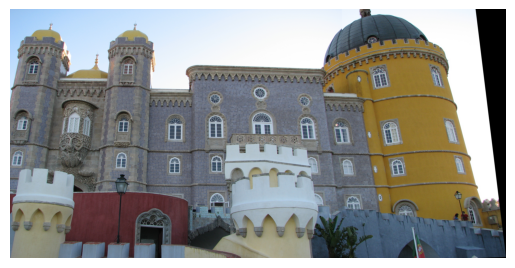

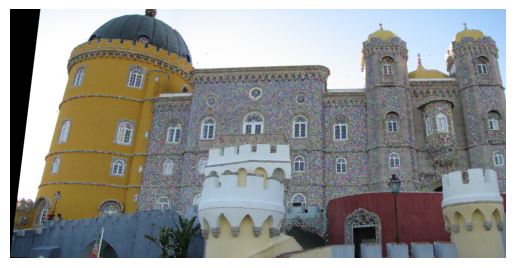

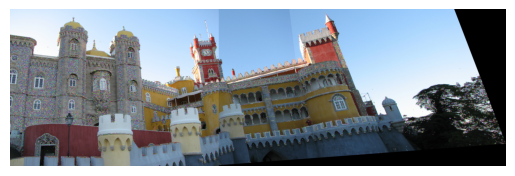

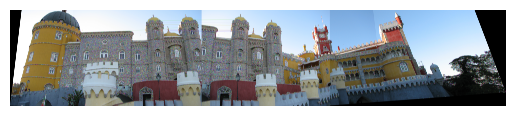

Computed Transformation Matrix H:
[[ 6.84407339e-01  1.05888383e-01  2.35040068e+03]
 [-1.72320066e-01  9.25394860e-01  1.57244477e+02]
 [-7.44985373e-05 -1.06685275e-06  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 6.01417044e-01  3.82036898e-01  2.32374348e+03]
 [-2.05747887e-01  1.00851648e+00  1.47390555e+02]
 [-1.15134787e-04  8.99463036e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 7.62528282e-01 -1.41279018e-01  2.36810083e+03]
 [-1.52807876e-01  8.23470835e-01  1.83957408e+02]
 [-4.73575273e-05 -7.26610230e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 6.14194485e-01  3.91297470e-01  2.30235733e+03]
 [-1.88618894e-01  9.41000691e-01  1.66838707e+02]
 [-1.03594716e-04  6.80633476e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 1.06584338e+00  3.15412993e-01  2.26080242e+03]
 [-1.42895460e-01  1.06919886e+00  1.13061295e+02]
 [ 1.40654888e-05  5.88505040e-05  1.00000000e+00]]
Computed Transformation Matrix H:
[[ 2.14224472e+00 -8.26970

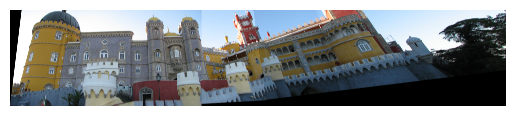

In [ ]:
# Load the images
im1 = cv2.imread(r'../data/sintra/sintra1.JPG')
im2 = cv2.imread(r'../data/sintra/sintra2.JPG')
im3 = cv2.imread(r'../data/sintra/sintra3.JPG')
im4 = cv2.imread(r'../data/sintra/sintra4.JPG')
im5 = cv2.imread(r'../data/sintra/sintra5.JPG')

images = [im1, im2, im3, im4, im5]

# Image stitching on 1 and 2
p1, p2 = getPoints_SIFT(images[1], images[0])
H = ransacH(p1, p2, nIter=1000, tol=2)
out_size = (images[1].shape[1] + images[0].shape[1], images[1].shape[0])
warped1 = cv2.warpPerspective(images[0], H, out_size)
stitched_images21 = imageStitching(images[1], warped1, warped_side='right')

# Image stitching on 21 and 3
p1, p2 = getPoints_SIFT(images[2], stitched_images21)
H = ransacH(p1, p2, nIter=1000, tol=2)
out_size = (images[2].shape[1] + stitched_images21.shape[1], images[1].shape[0])
warped21 = cv2.warpPerspective(stitched_images21, H, out_size)
stitched_images321 = imageStitching(images[2], warped21, warped_side='right')

# Image stitching on 4 and 5
p1, p2 = getPoints_SIFT(cv2.flip(images[3], 1), cv2.flip(images[4], 1))
H = ransacH(p1, p2, nIter=1000, tol=2)
out_size = (cv2.flip(images[3], 1).shape[1] + cv2.flip(images[4], 1).shape[1], cv2.flip(images[3], 1).shape[0])
warped5 = cv2.warpPerspective(cv2.flip(images[4], 1), H, out_size)
stitched_images54 = imageStitching(cv2.flip(images[3], 1), warped5, warped_side='right')

# Image stitching on 321 and 54
p1, p2 = getPoints_SIFT(cv2.flip(stitched_images54, 1), stitched_images321)
H = ransacH(p1, p2, nIter=1000, tol=2)
out_size = (stitched_images54.shape[1] + stitched_images321.shape[1], stitched_images54.shape[0])
warped321 = cv2.warpPerspective(stitched_images321, H, out_size)
stitched_images54321 = imageStitching(cv2.flip(stitched_images54, 1), warped321, warped_side='right')

Inputs: 
* `p1` and `p2` are matrices specifying point locations in each of the images and `p1[j]`,`p2[j]` are matched points between two images.

* `nIter` is the number of iterations to run RANSAC  

* `tol` is the tolerance value for considering a point to be an inlier. 

 * Define your function so that these  `nIter` and  `tol` have reasonable default values.

Outputs: 
* `bestH` is the homography model with the most inliers found during RANSAC

##### 3.7 - Be Creative:
---
* Go out and take at least 3 pictures of a far distance object (e.g. a building), and use what you have learned to create a new excellent Panorama image.
  * Add the resulted image to your report and to the `output` folder.

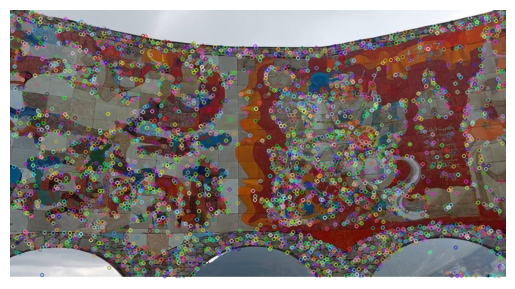

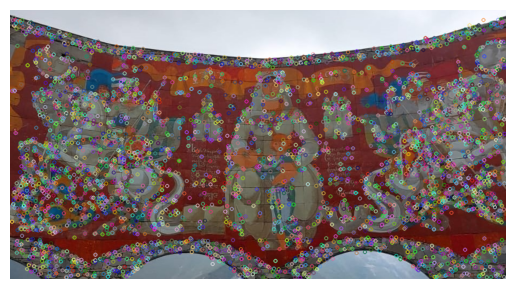

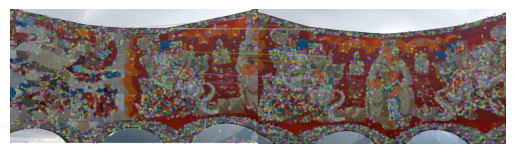

Computed Transformation Matrix H:
[[ 4.33702936e-01  1.26841789e-01  4.25887107e+02]
 [-2.76575327e-01  8.08341182e-01  6.11676424e+01]
 [-5.71746852e-04 -5.60091913e-05  1.00000000e+00]]


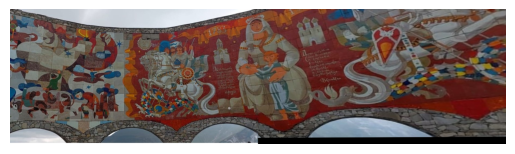

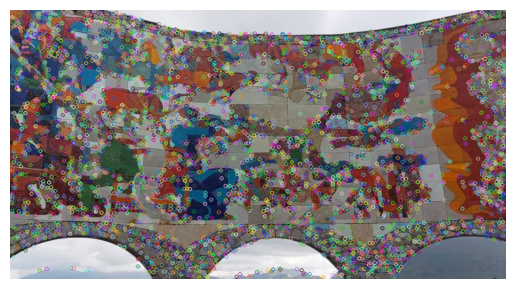

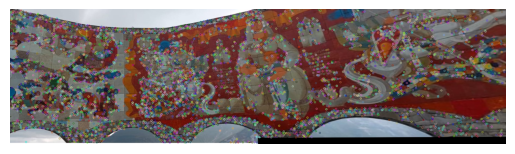

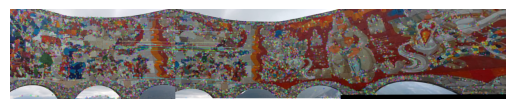

Computed Transformation Matrix H:
[[ 5.51596288e-01  1.07303753e-01  3.69500647e+02]
 [-2.06506423e-01  8.49630248e-01  4.95991711e+01]
 [-4.61523353e-04 -1.13321049e-05  1.00000000e+00]]


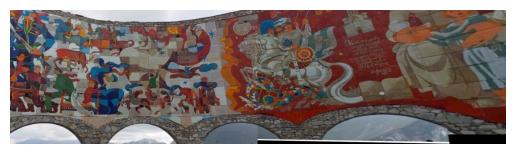

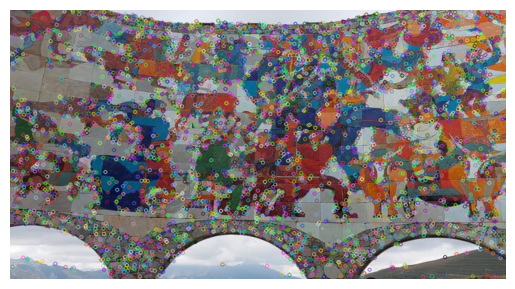

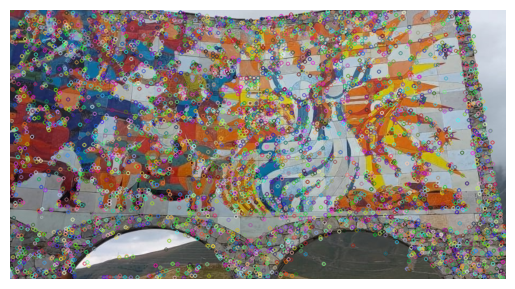

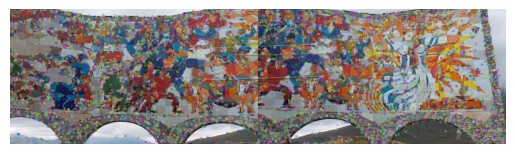

Computed Transformation Matrix H:
[[ 3.59831419e-01  7.31222873e-02  4.84847265e+02]
 [-2.92622727e-01  8.04856895e-01  8.17911337e+01]
 [-6.74111470e-04 -9.72422601e-05  1.00000000e+00]]


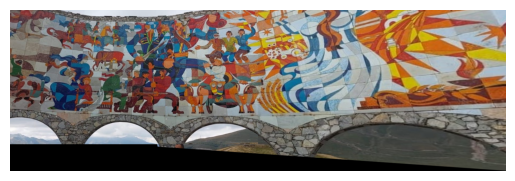

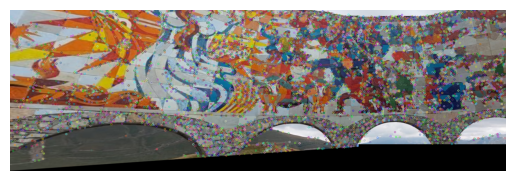

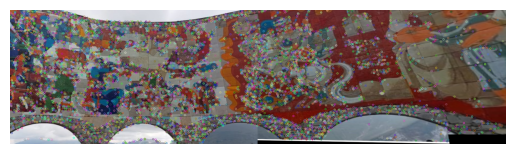

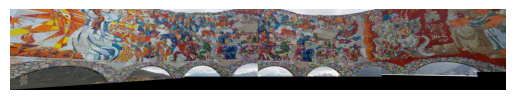

Computed Transformation Matrix H:
[[-9.99579153e-02  6.48217420e-02  1.27491206e+03]
 [-2.54889931e-01  7.84556869e-01  7.45776880e+01]
 [-5.85203107e-04 -4.14702204e-05  1.00000000e+00]]


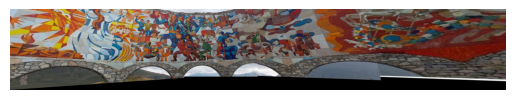

In [ ]:
# Load the images
im1 = cv2.imread(r'../data/my_data/panorama/im1.jpg')
im2 = cv2.imread(r'../data/my_data/panorama/im2.jpg')
im3 = cv2.imread(r'../data/my_data/panorama/im3.jpg')
im4 = cv2.imread(r'../data/my_data/panorama/im4.jpg')
im5 = cv2.imread(r'../data/my_data/panorama/im5.jpg')

images = [im1, im2, im3, im4, im5]

#Image stitching on 1 and 2
p1, p2 = getPoints_SIFT(images[1], images[0])
H = computeH(p1, p2)
out_size = (images[1].shape[1] + images[0].shape[1], images[1].shape[0] + images[1].shape[0])
warped1 = cv2.warpPerspective(images[0], H, out_size)
stitched_images21 = imageStitching(images[1], warped1, warped_side='right')

#Image stitching on 21 and 3
p1, p2 = getPoints_SIFT(images[2], stitched_images21)
H = computeH(p1, p2)
out_size = (images[2].shape[2] + stitched_images21.shape[1], images[1].shape[0] + images[1].shape[0])
warped21 = cv2.warpPerspective(stitched_images21, H, out_size)
stitched_images321 = imageStitching(images[2], warped21, warped_side='right')

#Image stitching on 4 and 5
p1, p2 = getPoints_SIFT(cv2.flip(images[3],1), cv2.flip(images[4],1))
H = computeH(p1, p2)
out_size = (cv2.flip(images[3],1).shape[1] + cv2.flip(images[4],1).shape[1], cv2.flip(images[3],1).shape[0] + cv2.flip(images[3],1).shape[0])
warped5 = cv2.warpPerspective(cv2.flip(images[4],1), H, out_size)
stitched_images54 = imageStitching(cv2.flip(images[3],1), warped5, warped_side='right')

#Image stitching on 321 and 54
p1, p2 = getPoints_SIFT(cv2.flip(stitched_images54,1), stitched_images321)
H = computeH(p1, p2)
out_size = stitched_images54.shape[1] + stitched_images321.shape[1], stitched_images54.shape[0] + stitched_images54.shape[0]
warped321 = cv2.warpPerspective(stitched_images321, H, out_size)
stitched_images54321 = imageStitching(cv2.flip(stitched_images54,1), warped321, warped_side='right')

#### Part 4 - Dry Questions
---
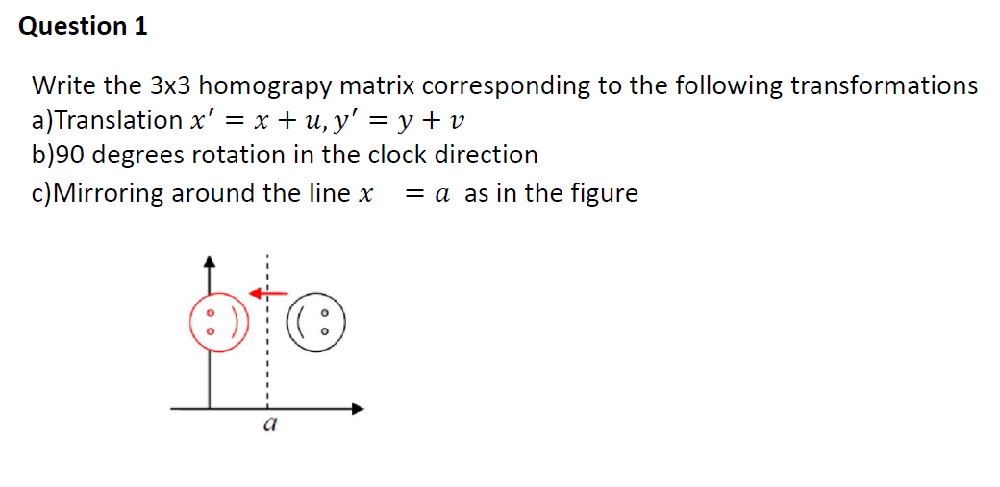



To calculate the homograpy matrix we need to multiply each matrix corresponding to a change in the image. Specifically:

$$
\begin{pmatrix}
-1 & 0 & 2a \\
0 & 1 & 0 \\
0 & 0 & 1
\end{pmatrix}
\cdot
\begin{pmatrix}
0 & 1 & 0 \\
-1 & 0 & 0 \\
0 & 0 & 1
\end{pmatrix}
\cdot
\begin{pmatrix}
1 & 0 & u \\
0 & 1 & v \\
0 & 0 & 1
\end{pmatrix}
=
\begin{pmatrix}
0 & -1 & 2a \\
-1 & 0 & 0 \\
0 & 0 & 1
\end{pmatrix}
\cdot
\begin{pmatrix}
1 & 0 & u \\
0 & 1 & v \\
0 & 0 & 1
\end{pmatrix}
=
\begin{pmatrix}
0 & -1 & 2a - v \\
-1 & 0 & -u \\
0 & 0 & 1
\end{pmatrix}
$$



---
## <img src="https://img.icons8.com/dusk/64/000000/prize.png" style="height:50px;display:inline"> Credits
* Images from <a href="http://www.image-net.org/">Imagenet</a>
* Videos from <a href="https://pixabay.com/videos/search/green%20screen/">Pixabay</a>
    * Dinosaur video from <a href="https://sites.google.com/a/sau17.net/modern-media/home/green-screen-animations">Modern Media</a>
* Icons from <a href="https://icons8.com/">Icon8.com</a> - https://icons8.com